<a href="https://colab.research.google.com/github/d-dimos/image_video_analysis_ntua/blob/main/img_Lab1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## <p style="text-align: center;"> Τεχνολογία και Ανάλυση Εικόνων και Βίντεο - Ροή Υ </p>
### 1η Εργαστηριακή Άσκηση, Άνοιξη 2021

    'Αμπατζή Ναυσικά (03117198) - nafsika.abatzi@gmail.com'
    'Δήμος Δημήτρης (03117165) - dimitris.dimos647@gmail.com'

### <font color='blue'> 1. Θεωρητικό Μέρος</font>

α) Το πρόβλημα που αναφέρεται σε αυτό το άρθρο είναι η αδυναμία επιλογής σωστής ανάλυσης κατά την κωδικοποίηση
και αποκωδικοποίηση εικόνων. Περιγράφεται μία νέα τεχνική, η οποία χρησιμοποιεί τεχνικές πρόβλεψης και μετασχηματισμούς. Η ιδέα είναι η αφαίρεση της συσχέτισης από την εικόνα χρησιμοποιώντας 
την Laplacian πυραμίδα. Σημαντική στην διαδικασία αυτή, είναι επίσης η χρήση του φίλτρου Gauss, η έλλειψη του οποίου (β) οδηγεί σε aliasing της εικόνας. Αυτό συμβαίνει διότι ο ρυθμός δειγματολήψίας δεν επαρκεί για την ανίχνευση όλων των αλλαγών της εικόνας. Αντίθετα η χρήση του Gaussian φίλτρου οδηγεί σε εξομάλυνση (smoothing) της εικόνας, προκειμένου να αφαιρεθούν οι απότομες αλλαγές (υψηλές συχνότητες) στις τιμές τις εικόνας, τις οποίες η υποδειγματοληψία χάνει. (γ) Όσον αφορά την κατασκευή της Laplacian πυραμίδας, αυτή αποτελεί μία ακολουθία από εικόνες $L_1,L_2,...,L_N$, οι οποίες προκύπτουν ως το αποτέλεσμα της διαφοράς δύο διαδοχικών επιπέδων της Gaussian πυραμίδας (με εξαίρεση το N-οστό). Αν συμβολίσουμε ως $g_i$ το $i$-οστό επίπεδο της Gaussian πυραμίδας, τότε $L_i = g_i - g_{i-1}$. Όμως το $g_{i-1}$ δεν έχει το ίδιο μέγεθος με το $g_i$, πρόβλημα που επιλύεται με χρήση μιας συνάρτησης ($EXPAND()$), η οποία μετατρέπει το μέγεθος του όρου $g_{i-1}$ σε ίσο με του $g_i$. Επομένως, πιο σωστά, ισχύει ότι $L_i = g_i - EXPAND(g_{i-1})$. Το κόστος κωδικοποιήσης είναι αρκετά μικρό, καθώς κωδικοποιούνται τα σφάλματα $L_{i}$ και όχι η αρχική εικόνα. Το αποτέλεσμα σε σχέση με την Gaussian πυραμίδα θα έχει πιο ακριβή αποτελέσματα σε χαρακτηριστικά της εικόνας.Επίσης η εικόνα $L_{n}$ = $g_{n}$ κωδικοποιείται με μικρότερο ρυθμό δειγματοληψίας, καθώς της έχει εφαρμοστεί πολλές φορές φιλτράρισμα και υποδειγματοληψία. (δ) Για να ανακτήσουμε την αρχική εικόνα από την Laplacian πυραμίδα, ουσιαστικά ακολουθείται η αντίστροφη διαδικασία της 
κατασκευής της πυραμίδας. Έτσι, με τη χρήση της συνάρτησης $EXPAND()$ ορίζουμε το μέγεθος της εικόνας $L_N$ ίσο με 
το μέγεθος της εικόνας $L_{N-1}$ και τις προσθέτουμε. Ακολουθούμε την διαδικασία αυτή μέχρι να φτάσουμε στο $L_0$. Η εξίσωση 
που περιγράφει αυτή την διαδικασία είναι η εξής:

$$g_l = L_l + EXPAND(g_l +1) \,\, \text{, για} \,\, l = N-1,N-2,\dots,0 \,\, \text{και} \,\, g_N = L_N$$

Όπως θα δούμε κι από τις εφαρμογές παρακάτω μπορούμε να ανακτήσουμε πλήρως την εικόνα.

### <font color='blue'> 2. Εργαστηριακό Μέρος</font>

#### A) Υλοποίηση Αλγορίθμου

In [ ]:
# imports
import urllib.request
import cv2 
import numpy as np
from matplotlib import pyplot as plt
from array import *
from scipy import signal
from scipy.fftpack import fft2,fftshift,ifftshift,ifft2
import scipy.ndimage as ndi
import scipy.stats as st
import statistics
from skimage import color, data, img_as_float,img_as_ubyte
%matplotlib inline

In [ ]:
# (α) Produces a Generating Kernel
def Gkernel(a): 
    b = 1/4
    c = 1/4 - a/2
    kernel1D = np.array([[c], [b], [a], [b], [c]])
    kernel = kernel1D @ kernel1D.T
    return kernel

In [ ]:
# (β) Convolution with kernel and down-sampling
def GREDUCE(I, h): 
    I_out = cv2.filter2D(I, -1, h)
    I_out = cv2.resize(I_out, (I_out.shape[1]//2, I_out.shape[0]//2), interpolation=cv2.INTER_AREA)
    return I_out

In [ ]:
# (γ) Produces Gaussian Pyramid
def GPyramid(I, a, depth):  
    G = [I] # g^0 = I (initial image), base of the pyramid
    temp = I
    h = Gkernel(a)
    for i in range(depth-1):
        temp = GREDUCE(temp, h)
        G.append(temp)
    return G

In [ ]:
# (δ) Up-sampling and convolution with kernel
def GEXPAND(I,h):
    x = cv2.resize(I, (I.shape[1]*2, I.shape[0]*2), interpolation=cv2.INTER_AREA)
    I_out = cv2.filter2D(x,-1,h)
    return x

In [ ]:
# (ε) Produces Laplacian Pyramid
def LPyramid(I,a,depth):
    h = Gkernel(a)
    G = GPyramid(I, a, depth)
    L = [G[depth-1]]
    for n in range(depth-1):
        interpolation = GEXPAND(G[depth-n-1],h)
        difference = G[depth-n-2] - interpolation + 128
        L.append(difference)
    L.reverse()
    return L

In [ ]:
# (στ) Decodes Laplacian Pyramid into image
def L_Pyramid_Decode(L,a):
    N = len(L)
    R = L[N-1]
    h = Gkernel(a)
    for n in range(N-1):
        R = GEXPAND(R,h)
        R = R + L[N-n-2] - 128
    return R

In [ ]:
def L_Quantization(Im,bins):
    q = np.linspace(0,255,num = bins)
    roll = np.roll(q,-1)
    roll[-1] = 255
    Q = (np.digitize(Im,q) + np.digitize(Im,roll)) //2 
    return Q.astype(np.uint8)

#### Β) Δοκιμές Αλγορίθμου

In [ ]:
'''
    Auxiliary Function to print multiple images
    - images: input images to print
    - titles: corresponding titles
'''
def printMultiple (images, titles, color):
    if color != 'gray':
        color = 'viridis'
    num = len(images)
    ax = np.zeros(num)
    f, ax = plt.subplots(1, num, figsize=(20, 20))
    for i in range(num):
        ax[i].imshow(images[i], cmap=color) 
        ax[i].set_title(titles[i], fontsize=14)
    return

###### (α) Testing L_Pyramid() and L_Pyramid_Decode()

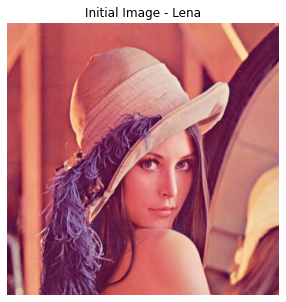

In [ ]:
# load Lena
HTTP_response = urllib.request.urlopen('http://www.image.ntua.gr/~tpar/LABimage/lena.png')
arr = np.asarray(bytearray(HTTP_response.read()), dtype=np.uint8)
BGR_Lena = cv2.imdecode(arr,-1)
RGB_Lena = cv2.cvtColor(BGR_Lena, cv2.COLOR_BGR2RGB)
R_Lena =  RGB_Lena[:,:,0]
G_Lena =  RGB_Lena[...,1]
B_Lena =  RGB_Lena[...,2]
plt.figure(figsize=(5,5))
plt.title('Initial Image - Lena')
plt.imshow(RGB_Lena)
_ = plt.axis('off')

In [ ]:
def checkChannel (img, channel, a, depth):
    # original image
    #L = img
    plt.figure()
    if channel != 'gray':
        plt.title('Initial Image: Channel '+channel)
        plt.imshow(img)
    else:
        plt.title('Initial Grayscale Image')
        plt.imshow(img, cmap='gray')
    
    # Laplacian Pyramid
    LPT = LPyramid(img, a, depth)
    decoded = L_Pyramid_Decode(LPT, a)
    titles = ['LP_' + channel + '[' + str(i) +']' for i in range(depth)]
    printMultiple(LPT, titles, channel)

    # decoded image
    plt.figure()
    if channel != 'gray':
        plt.title("Decoded Image: Channel "+channel)
        plt.imshow(decoded)
    else:
        plt.title("Grayscale Decoded Image")
        plt.imshow(decoded, cmap='gray')
    

    # check for loss during reconstruction
    if (decoded == img).all():
        print('Decoded image channel matches the original one completely')
    return decoded

Decoded image channel matches the original one completely


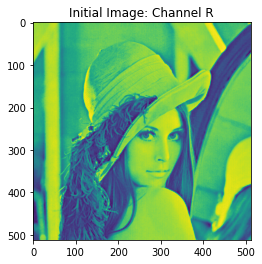

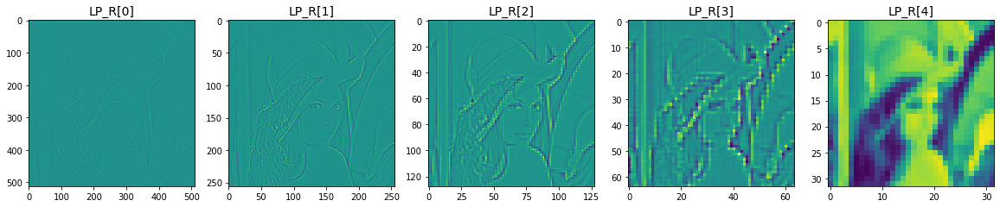

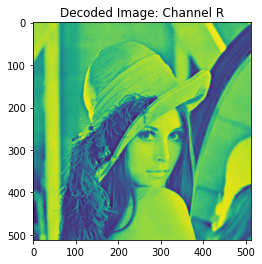

In [ ]:
imgDecode_R = checkChannel(R_Lena, 'R', 0.5, 5)

Decoded image channel matches the original one completely


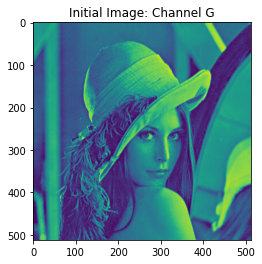

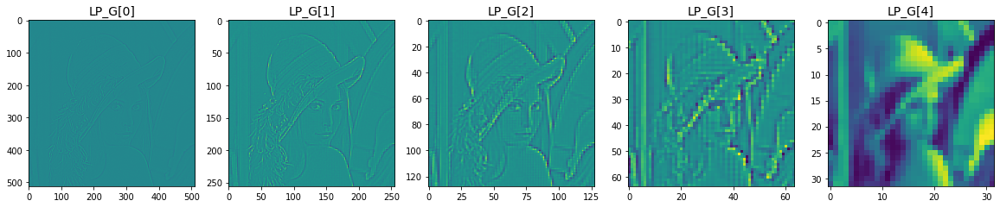

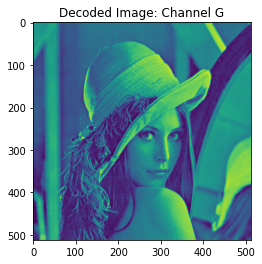

In [ ]:
imgDecode_G = checkChannel(G_Lena, 'G', 0.5, 5)

Decoded image channel matches the original one completely


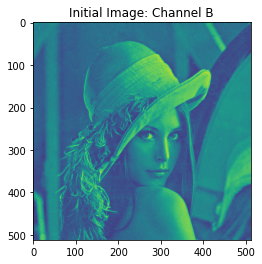

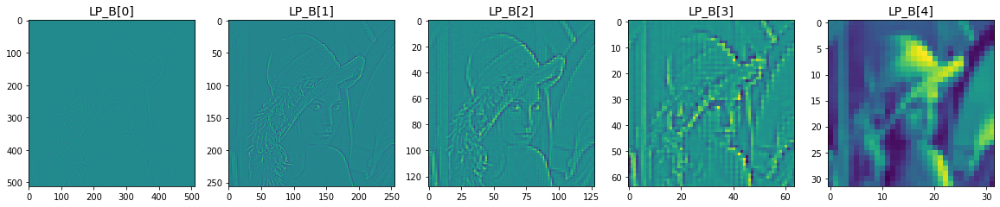

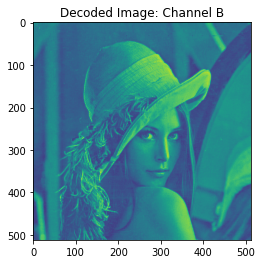

In [ ]:
imgDecode_B = checkChannel(B_Lena, 'B', 0.5, 5)

Merged image matches the original one completely


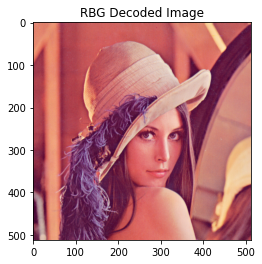

In [ ]:
# we now merge the 3 channels
merged = cv2.merge((imgDecode_R, imgDecode_G, imgDecode_B))
plt.imshow(merged)
plt.title('RBG Decoded Image')

if (merged == RGB_Lena).all():
    print('Merged image matches the original one completely')

Decoded image channel matches the original one completely


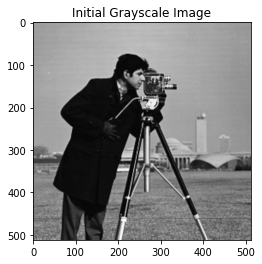

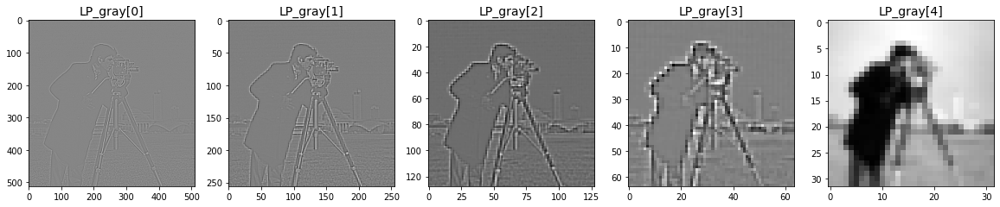

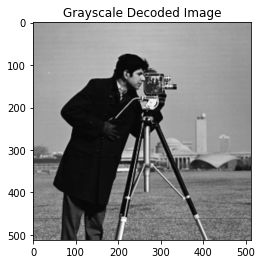

In [ ]:
# Repeat for camera image (grayscale testing) - depth = 5, a = 0.5
camera = data.camera()
cameraDecode = checkChannel(camera, 'gray', 0.5, 5)

Παρατηρούμε ότι η ανακατασκευή και των δύο εικόνων από την Laplacian πυραμίδα είναι τέλεια για όλες τις τιμές του depth.

###### (β) Testing L_Pyramid() and L_Pyramid_Decode() for different values of 'a'

In [ ]:
def testing (img, channel, a, depth, mode):
    L = img
    
    # Laplacian Pyramid
    LPT = LPyramid(L, a, depth)
    decoded = L_Pyramid_Decode(LPT, a)
    if mode == 'a':
        titles = ['a = '+str(a) for i in range(depth)]
    else:
        titles = ['depth = '+str(depth) for i in range(depth)]  
    printMultiple(LPT, titles, channel)
    
    # check for loss during reconstruction
    if (decoded == img).all():
        print('Decoded image channel matches the original one completely')
    return (decoded, LPT)

In [ ]:
a = np.arange(0.2,0.8,0.1)[:-1]

Decoded image channel matches the original one completely
Decoded image channel matches the original one completely
Decoded image channel matches the original one completely
Decoded image channel matches the original one completely
Decoded image channel matches the original one completely
Decoded image channel matches the original one completely


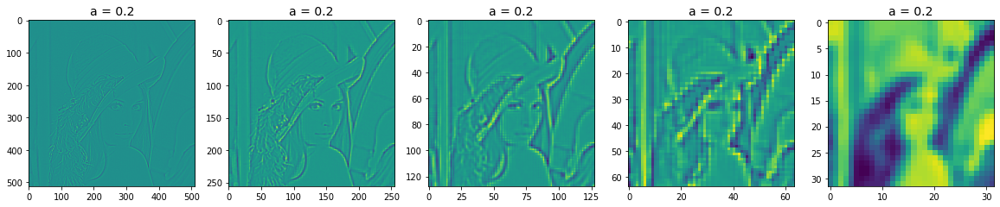

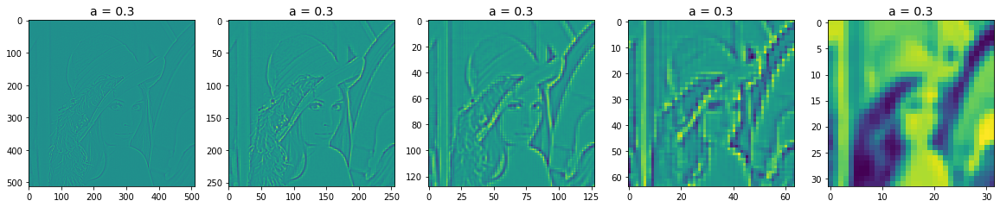

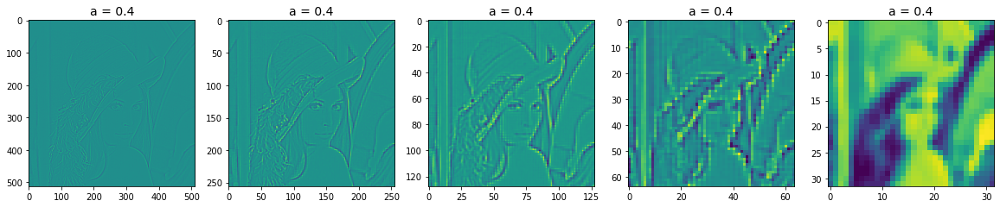

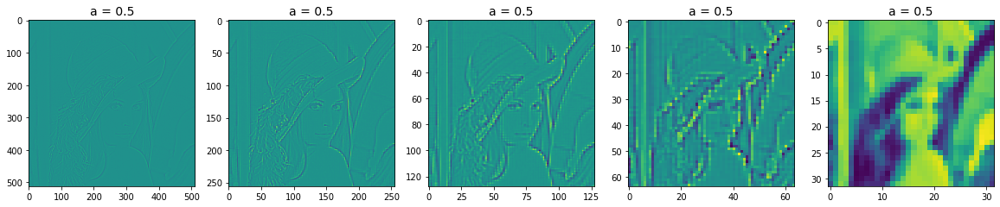

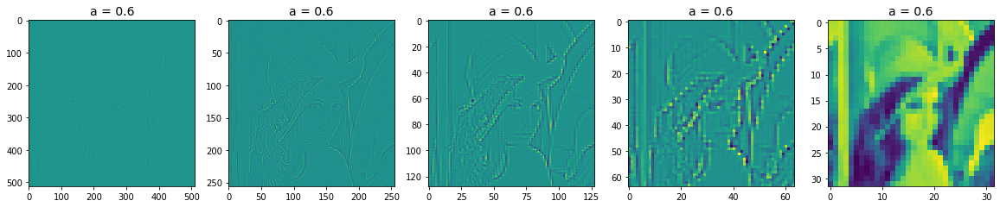

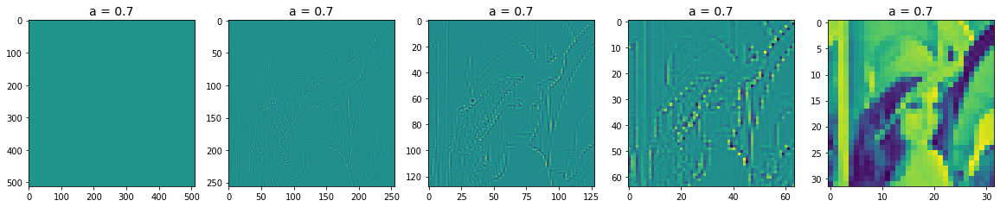

In [ ]:
R_testing = []
Lena_R_a = []
for i in a:
    decoded, LPT = testing(R_Lena, 'R', round(i,1), 5, 'a')
    R_testing.append(decoded)
    Lena_R_a.append(LPT)

Decoded image channel matches the original one completely
Decoded image channel matches the original one completely
Decoded image channel matches the original one completely
Decoded image channel matches the original one completely
Decoded image channel matches the original one completely
Decoded image channel matches the original one completely


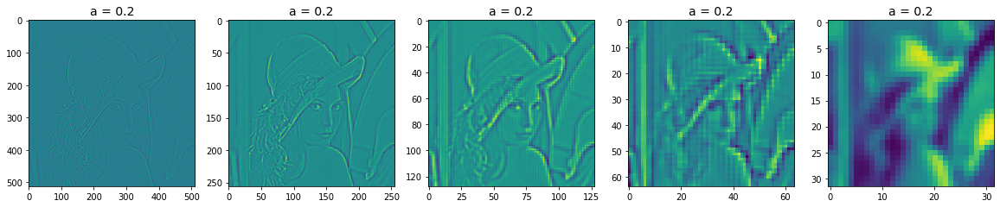

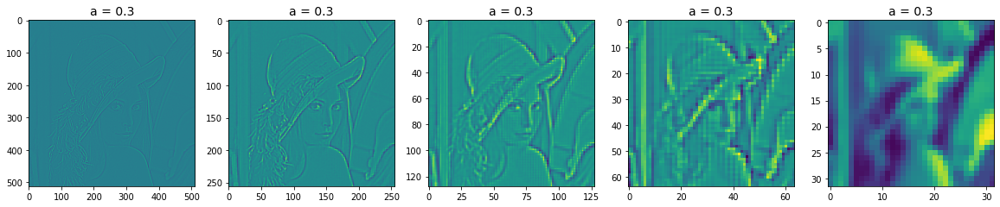

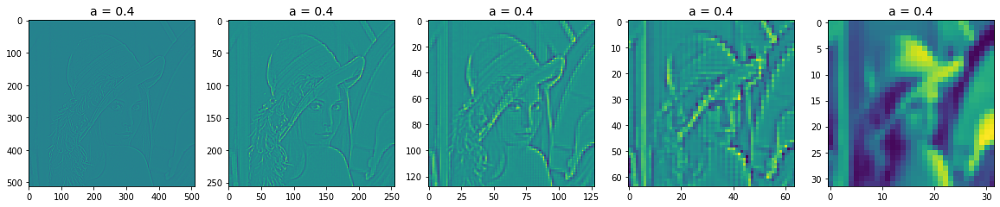

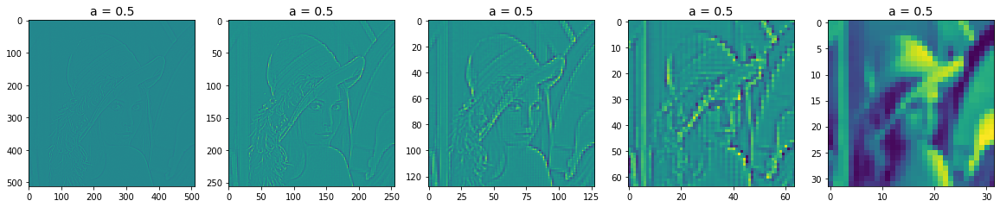

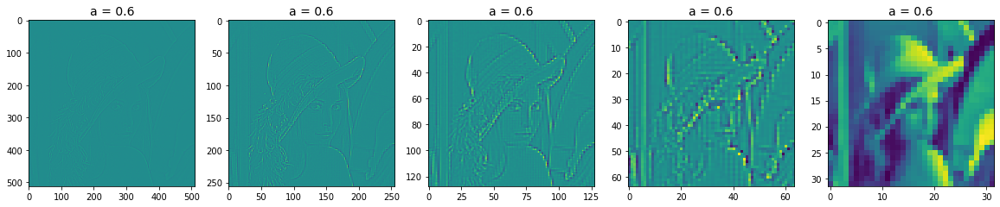

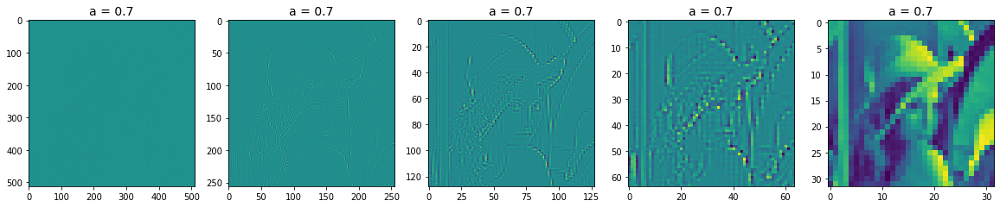

In [ ]:
G_testing = []
Lena_G_a = []
for i in a:
    decoded, LPT = testing(G_Lena, 'G', round(i,1), 5, 'a')
    G_testing.append(decoded)
    Lena_G_a.append(LPT)

Decoded image channel matches the original one completely
Decoded image channel matches the original one completely
Decoded image channel matches the original one completely
Decoded image channel matches the original one completely
Decoded image channel matches the original one completely
Decoded image channel matches the original one completely


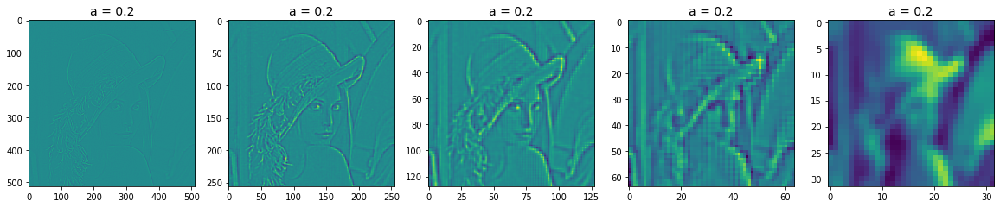

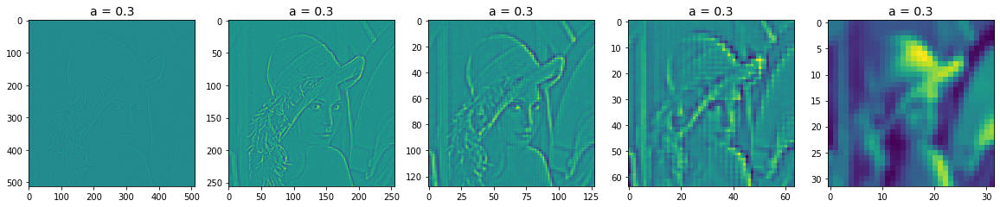

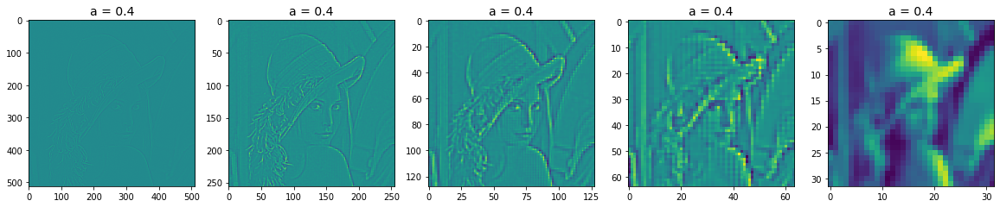

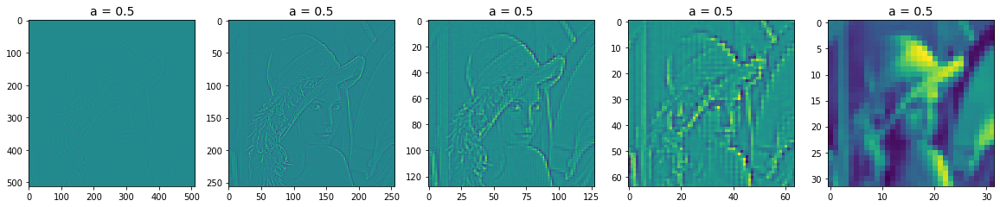

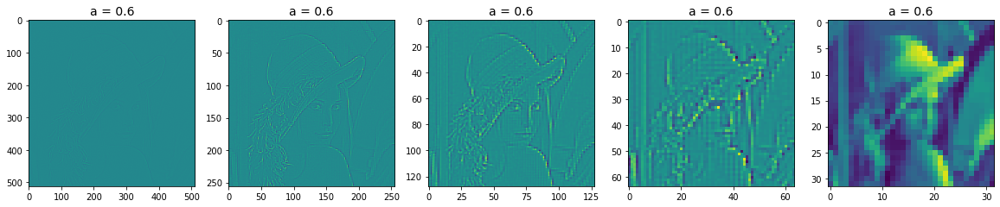

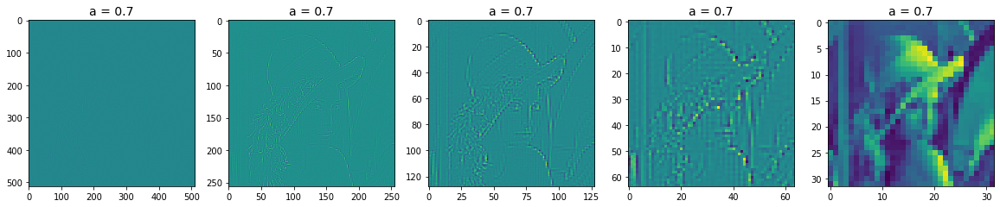

In [ ]:
B_testing = []
Lena_B_a = []
for i in a:
    decoded, LPT = testing(B_Lena, 'B', round(i,1), 5, 'a')
    B_testing.append(decoded)
    Lena_B_a.append(LPT)

True
True
True
True
True
True


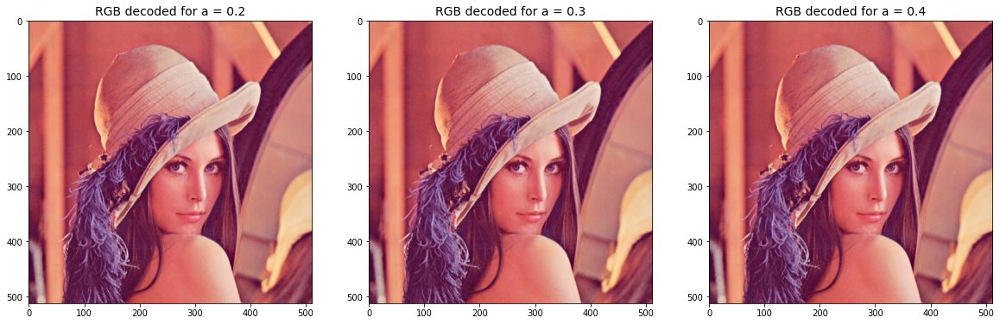

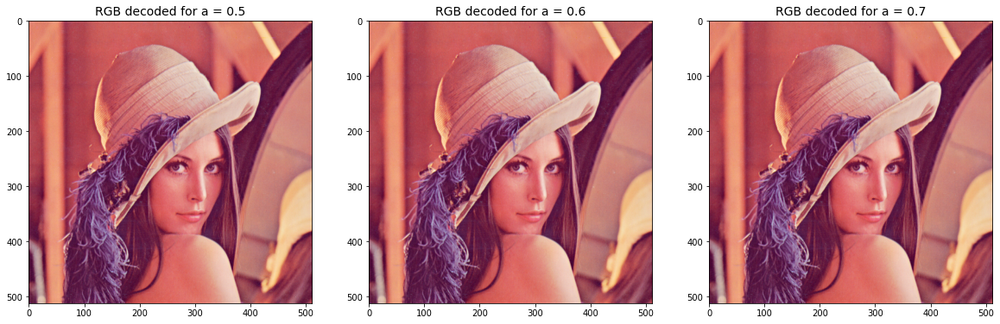

In [ ]:
merged_test = []
for i in range(len(a)):
    x = cv2.merge((R_testing[i], G_testing[i], B_testing[i]))
    merged_test.append(x)
    print((x == RGB_Lena).all())
    
titles = ['RGB decoded for a = '+str(round(i,1)) for i in a]

printMultiple(merged_test[:3], titles[:3], 'color')
printMultiple(merged_test[3:], titles[3:], 'color')

Decoded image channel matches the original one completely
Decoded image channel matches the original one completely
Decoded image channel matches the original one completely
Decoded image channel matches the original one completely
Decoded image channel matches the original one completely
Decoded image channel matches the original one completely


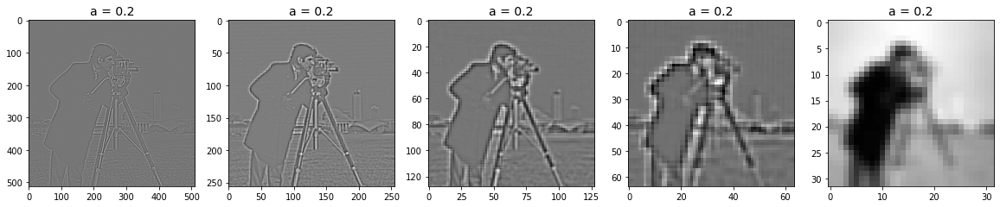

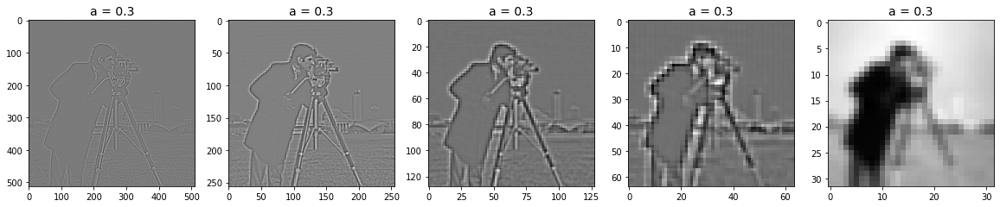

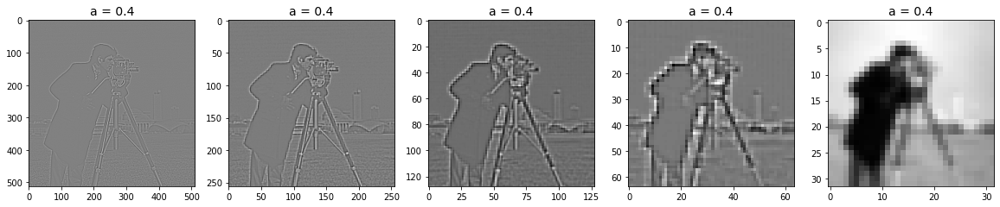

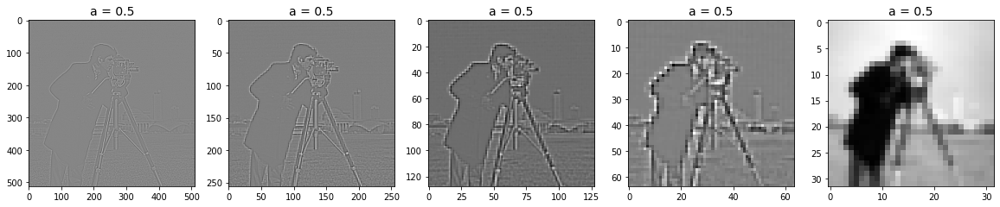

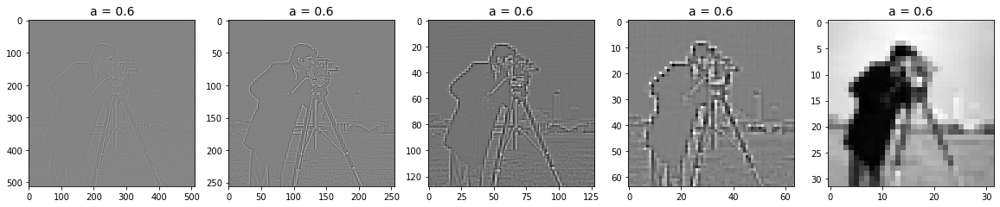

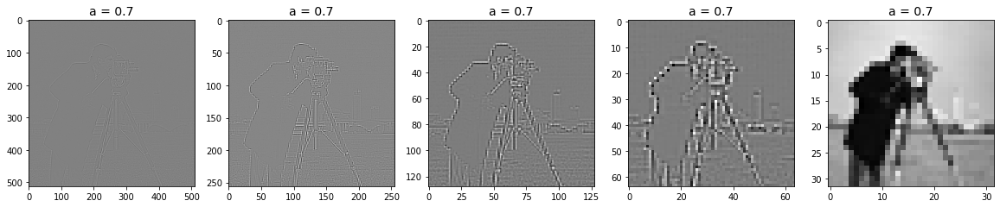

In [ ]:
camera_testing = []
camera_LPT_a = []
for i in a:
    decoded, LPT = testing(camera, 'gray', round(i,1), 5, 'a')
    camera_testing.append(decoded)
    camera_LPT_a.append(LPT)

True
True
True
True
True
True


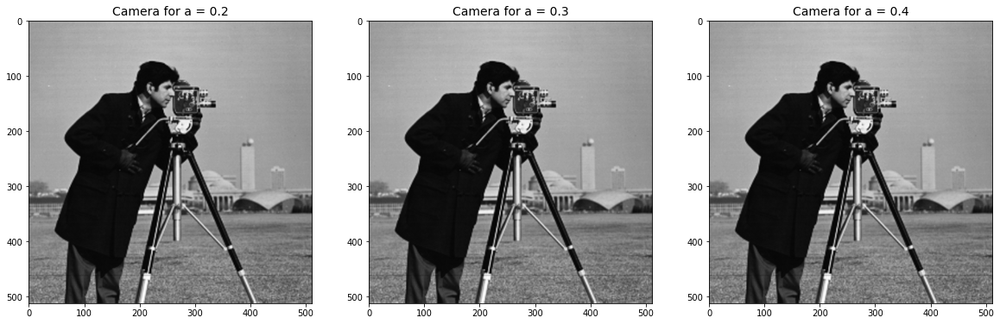

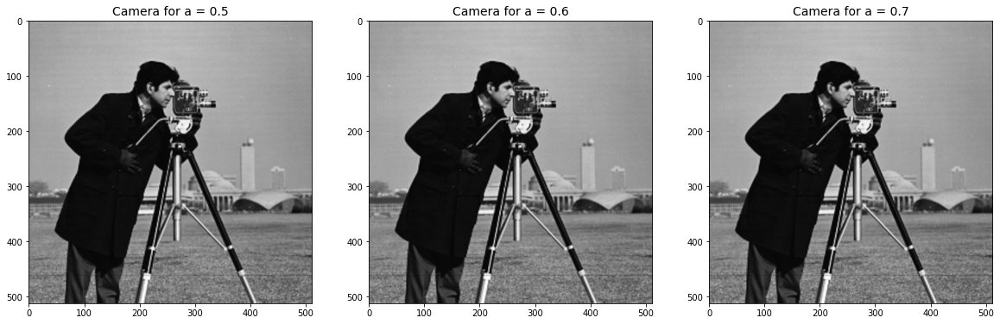

In [ ]:
for i in range(len(a)):
        print((camera_testing[i] == camera).all())
titles = ['Camera for a = '+str(round(i,1)) for i in a]

printMultiple(camera_testing[:3], titles[:3], 'gray')
printMultiple(camera_testing[3:], titles[3:], 'gray')

Παρατηρούμε ότι για κάθε 'a' η ανακατασκευή και των δύο εικόνων ήταν πλήρης, εφόσον ο έλεγχος έχει αποτέλεσμα true. Επίσης παρατηρούμε ότι η αύξηση του 'a' οδηγεί σε περισσότερο blurring των επιπέδων της Λαπλασιανής πυραμίδας.Τέλος, στο L0 επίπεδο όλων των πυραμίδων οι εικόνες διακρίνονται όλο και πιο δύσκολα όσο αυξάνουμε την τιμή του 'a'.

###### (γ) Testing L_Pyramid() and L_Pyramid_Decode() for different values of 'depth'

In [ ]:
depth = np.arange(2,8,1)

Decoded image channel matches the original one completely
Decoded image channel matches the original one completely
Decoded image channel matches the original one completely
Decoded image channel matches the original one completely
Decoded image channel matches the original one completely
Decoded image channel matches the original one completely


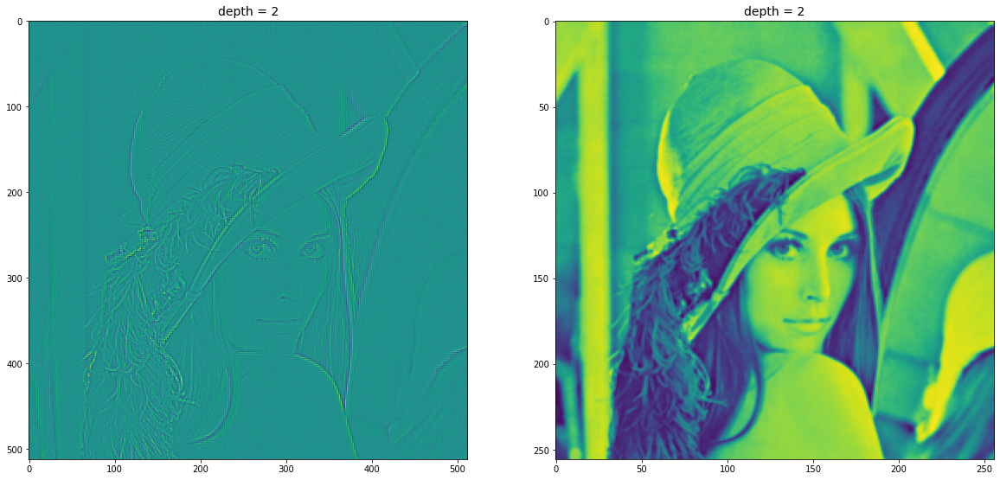

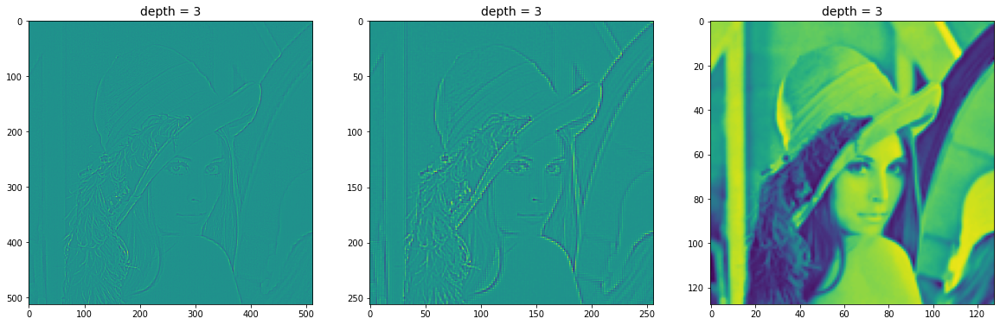

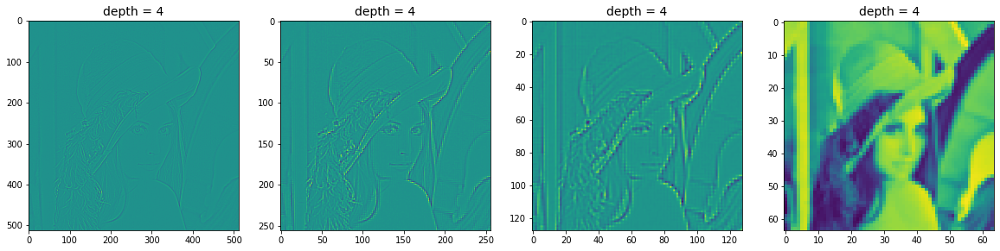

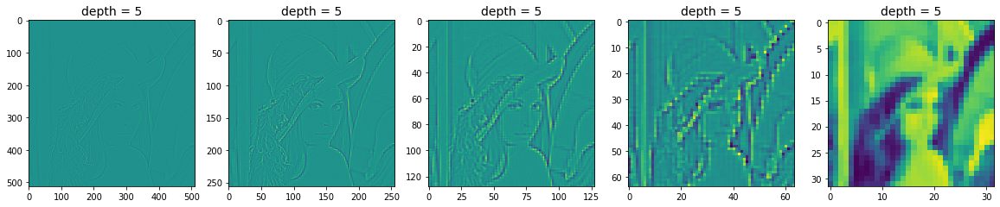

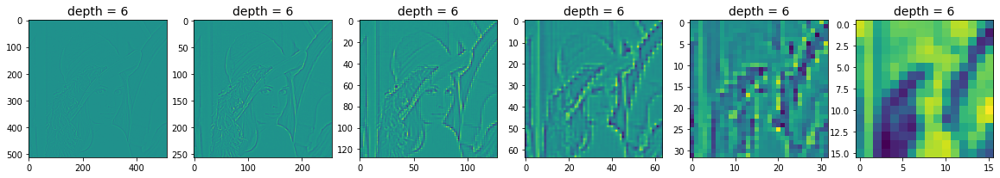

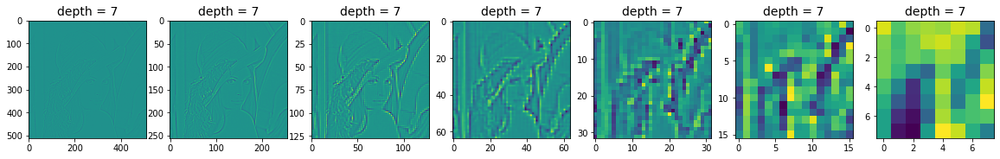

In [ ]:
R_testing = []
Lena_R_depth = []
for i in depth:
    decoded, LPT = testing(R_Lena, 'R', a=0.5, depth=i, mode='depth')
    R_testing.append(decoded)
    Lena_R_depth.append(LPT)

Decoded image channel matches the original one completely
Decoded image channel matches the original one completely
Decoded image channel matches the original one completely
Decoded image channel matches the original one completely
Decoded image channel matches the original one completely
Decoded image channel matches the original one completely


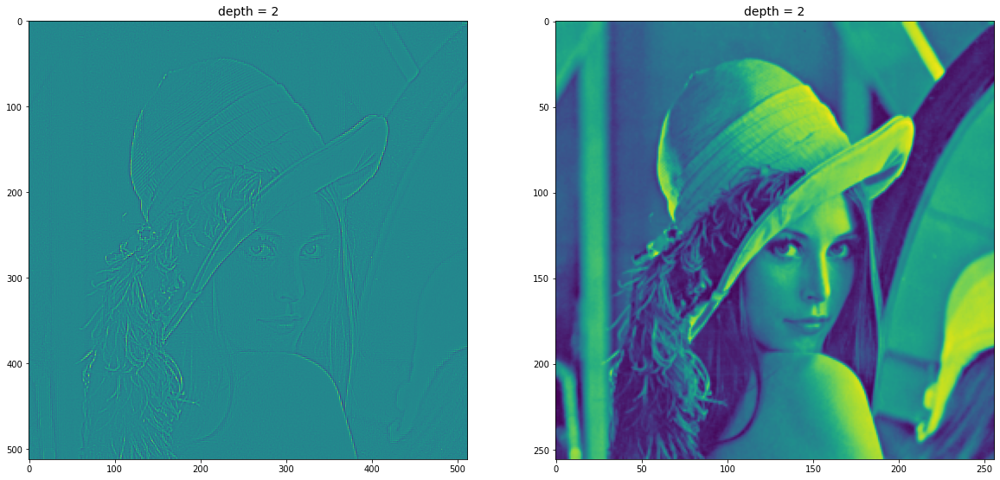

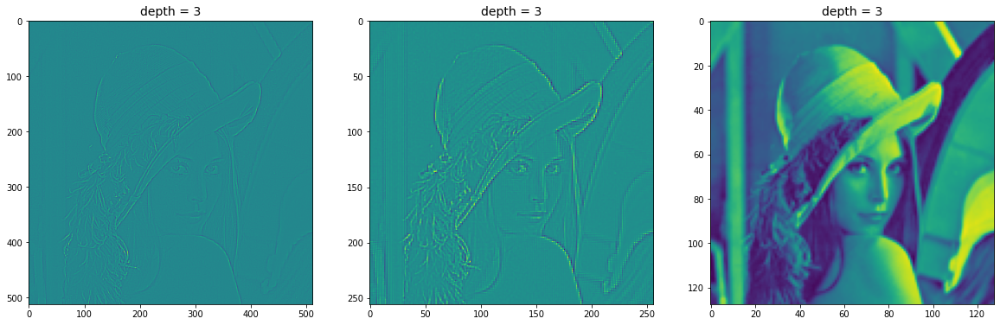

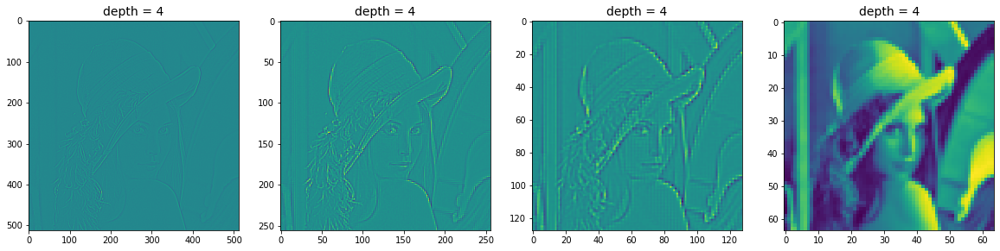

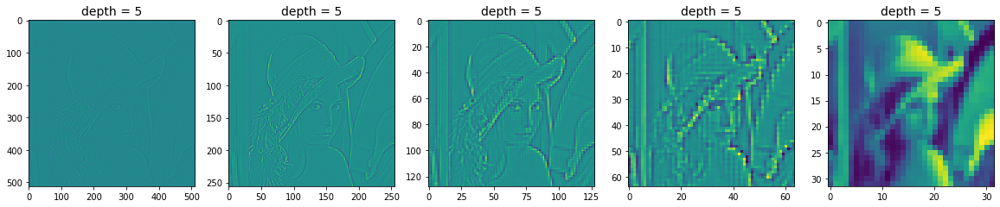

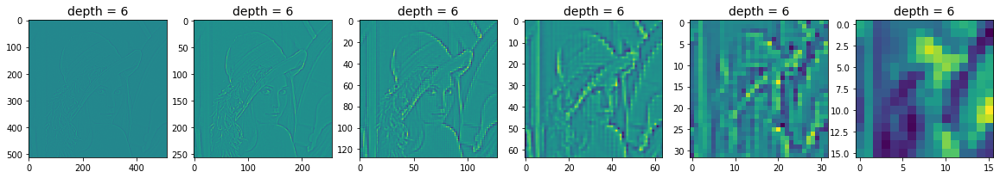

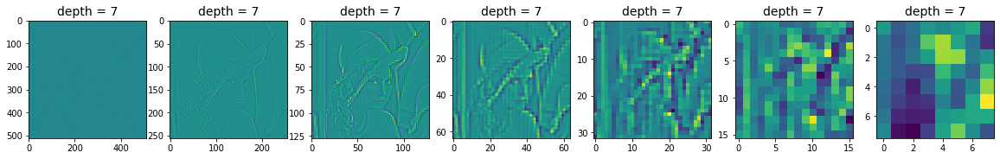

In [ ]:
G_testing = []
Lena_G_depth = []
for i in depth:
    decoded, LPT = testing(G_Lena, 'G', a=0.5, depth=i, mode='depth')
    G_testing.append(decoded)
    Lena_G_depth.append(LPT)

Decoded image channel matches the original one completely
Decoded image channel matches the original one completely
Decoded image channel matches the original one completely
Decoded image channel matches the original one completely
Decoded image channel matches the original one completely
Decoded image channel matches the original one completely


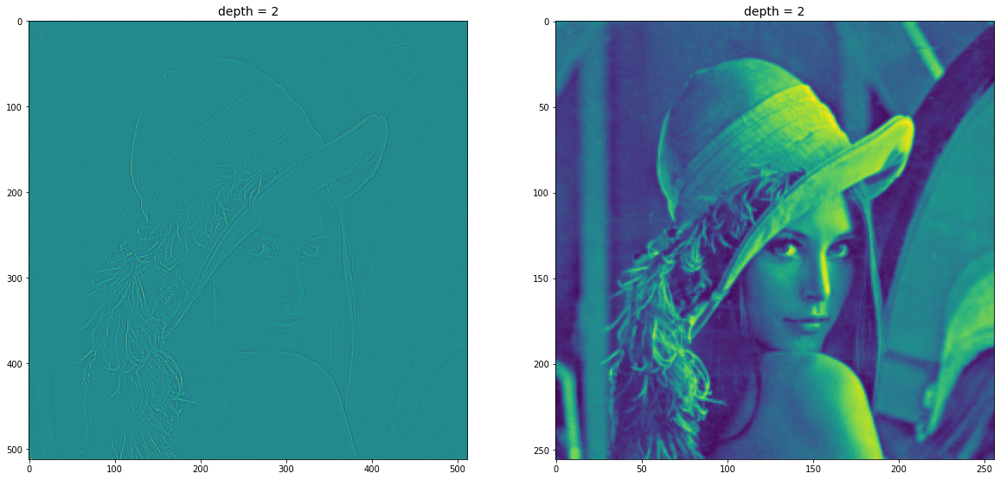

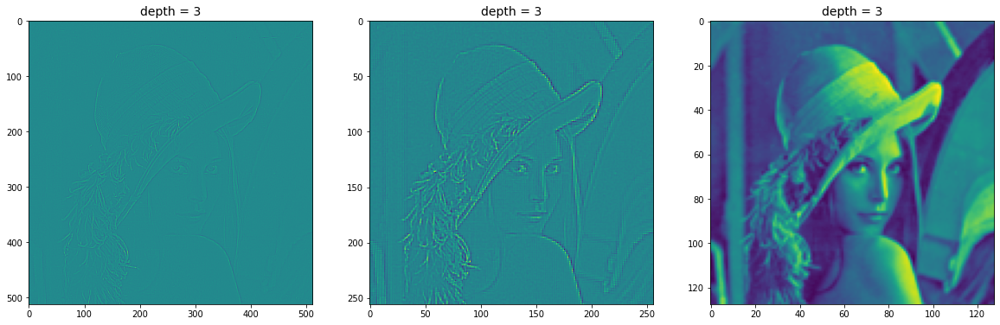

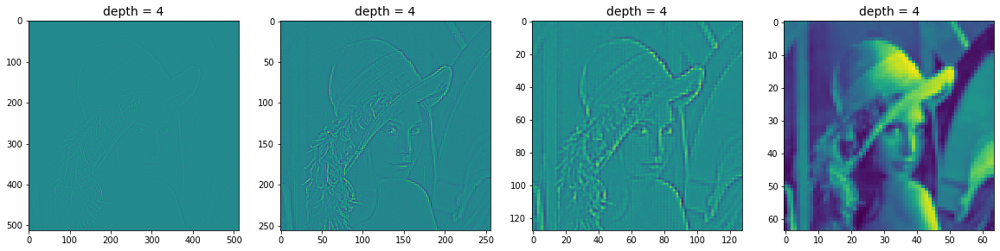

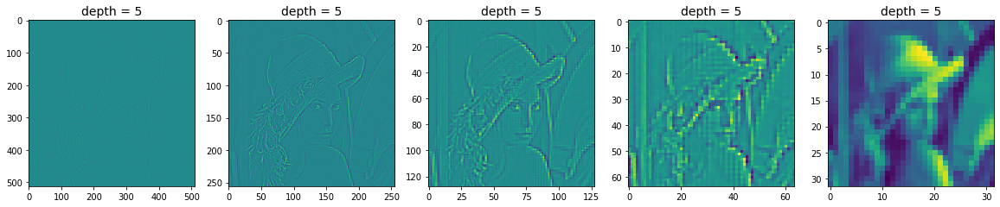

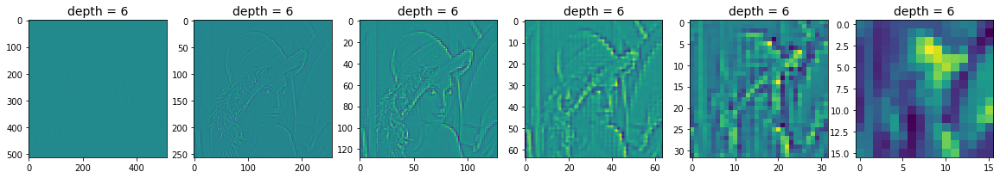

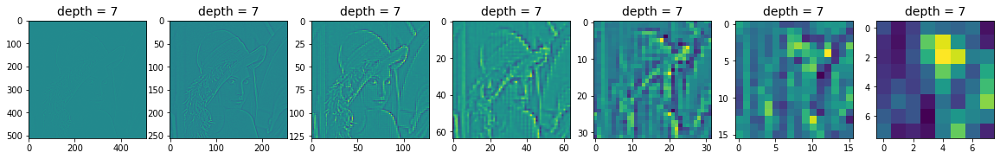

In [ ]:
B_testing = []
Lena_B_depth = []
for i in depth:
    decoded, LPT = testing(B_Lena, 'B', a=0.5, depth=i, mode='depth')
    B_testing.append(decoded)
    Lena_B_depth.append(LPT)

True
True
True
True
True
True


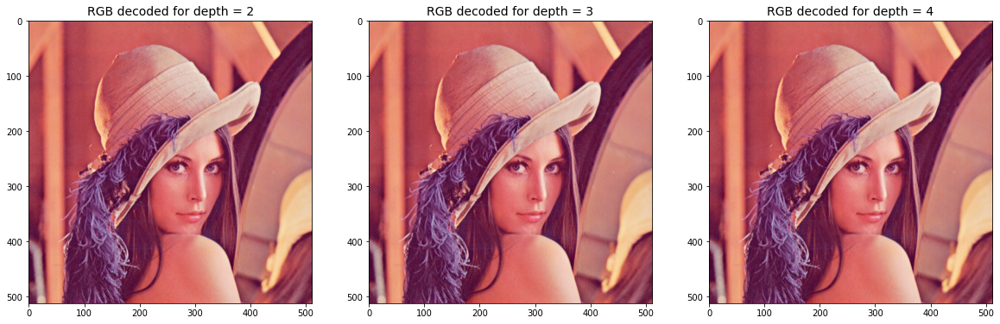

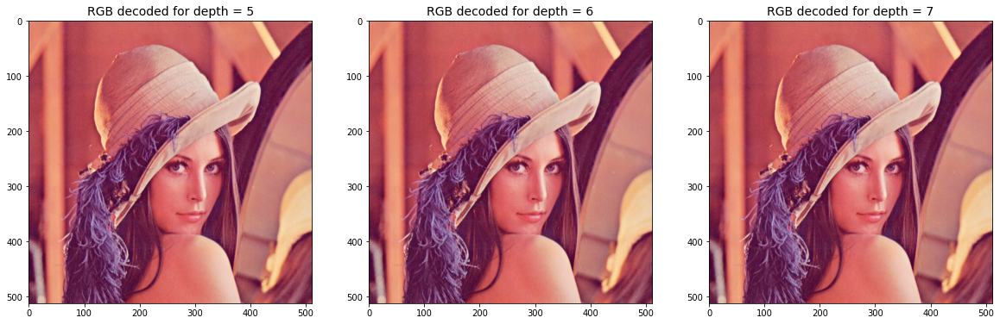

In [ ]:
merged_test = []
for i in range(len(a)):
    x = cv2.merge((R_testing[i], G_testing[i], B_testing[i]))
    merged_test.append(x)
    print((x == RGB_Lena).all())
    
titles = ['RGB decoded for depth = '+str(i) for i in depth]

printMultiple(merged_test[:3], titles[:3], 'color')
printMultiple(merged_test[3:], titles[3:], 'color')

Decoded image channel matches the original one completely
Decoded image channel matches the original one completely
Decoded image channel matches the original one completely
Decoded image channel matches the original one completely
Decoded image channel matches the original one completely
Decoded image channel matches the original one completely


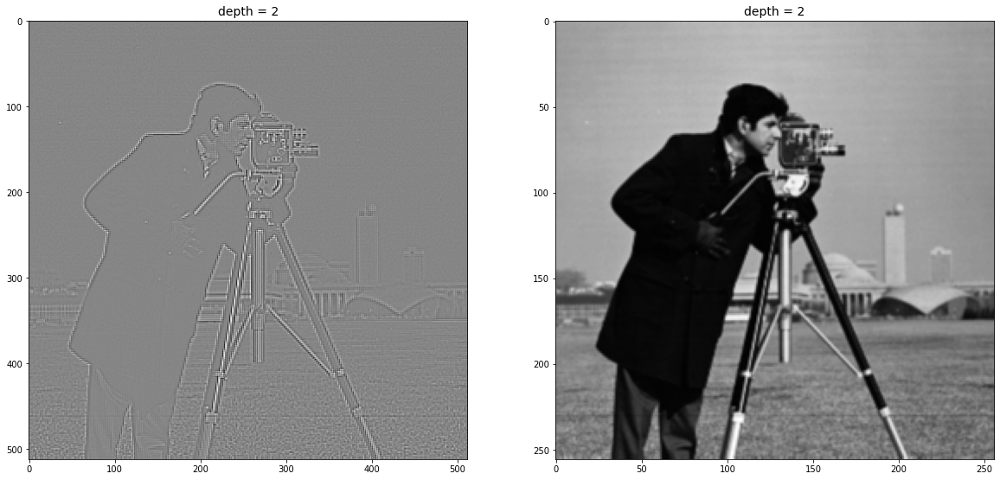

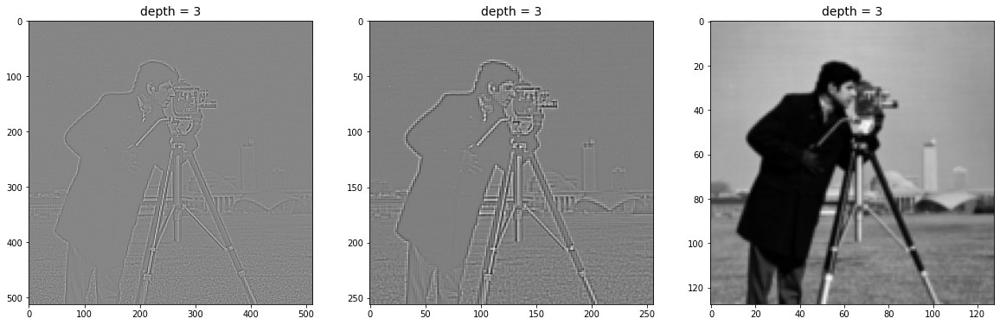

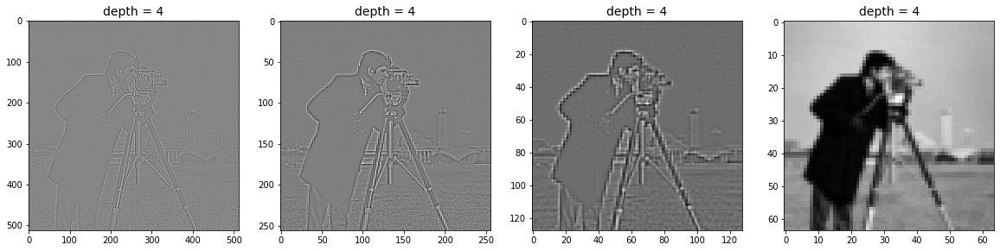

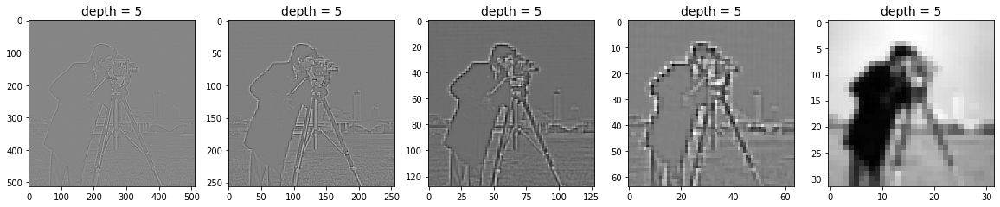

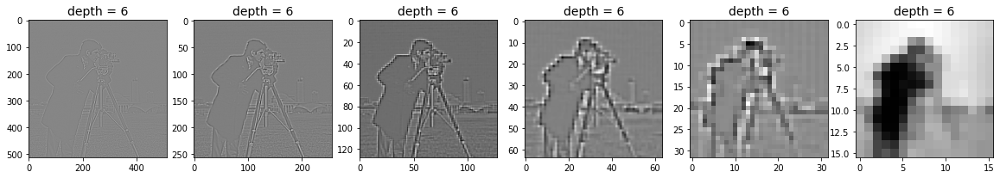

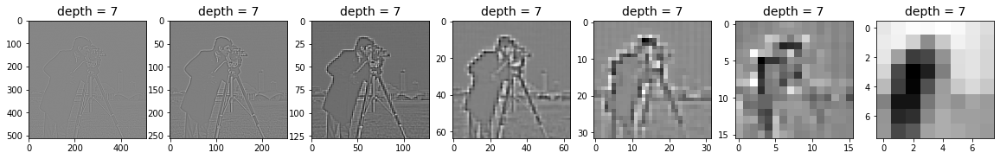

In [ ]:
camera_testing = []
camera_LPT_depth = []
for i in depth:
    decoded, LPT = testing(camera, 'gray', a=0.5, depth=i, mode='depth')
    camera_testing.append(decoded)
    camera_LPT_depth.append(LPT)

True
True
True
True
True
True


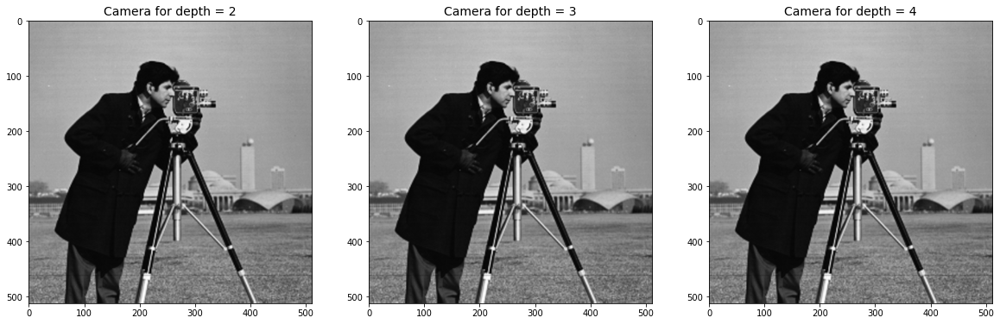

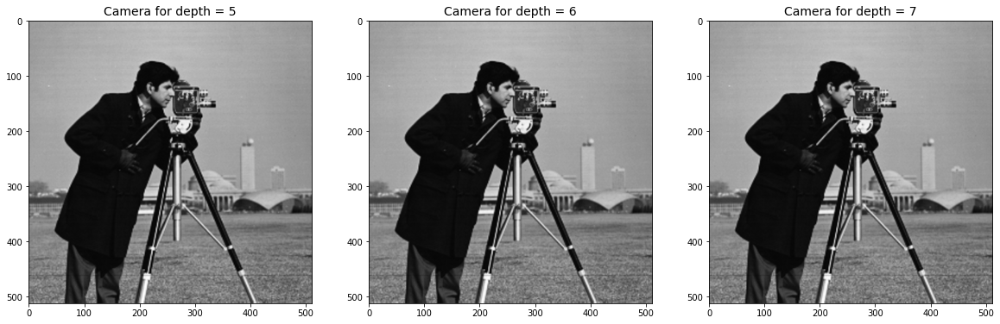

In [ ]:
for i in range(len(depth)):
        print((camera_testing[i] == camera).all())
titles = ['Camera for depth = '+str(i) for i in depth]

printMultiple(camera_testing[:3], titles[:3], 'gray')
printMultiple(camera_testing[3:], titles[3:], 'gray')

Παρατηρούμε ότι για σταθερή τιμή του 'a' και αυξανόμενο depth, σε κάθε περίπτωση η εικόνα ανακτάται πλήρως από την Λαπλασιανή πυραμίδα.

###### (δ) Calculating Entropy and Histograms

In [ ]:
a = np.arange(0.2,0.8,0.1)[:-1]
def entropy_histograms (pyramid, a, depth):
    sum_hist = np.zeros([256,1], np.float64)
    histograms = []
    for n in range(depth-1):
        hist = cv2.calcHist([pyramid[n]], [0], None, [256], [0, 256])
        sum_hist += hist 
    entropy = st.entropy(sum_hist, base=2)[0]
    
    return (sum_hist, entropy)

**Testing for different values of a**

In [ ]:
# Lena Channel R
Lena_R_histograms = []
entropies_R = []
for i in range(len(a)):
    histograms, entropy = entropy_histograms(Lena_R_a[i], a[i], depth=5)
    Lena_R_histograms.append(histograms)
    entropies_R.append(entropy)

In [ ]:
# Lena Channel G
Lena_G_histograms = []
entropies_G = []
for i in range(len(a)):
    histograms, entropy = entropy_histograms(Lena_G_a[i], a[i], depth=5)
    Lena_G_histograms.append(histograms)
    entropies_G.append(entropy)

In [ ]:
# Lena Channel B
Lena_B_histograms = []
entropies_B = []
for i in range(len(a)):
    histograms, entropy = entropy_histograms(Lena_B_a[i], a[i], depth=5)
    Lena_B_histograms.append(histograms)
    entropies_B.append(entropy)

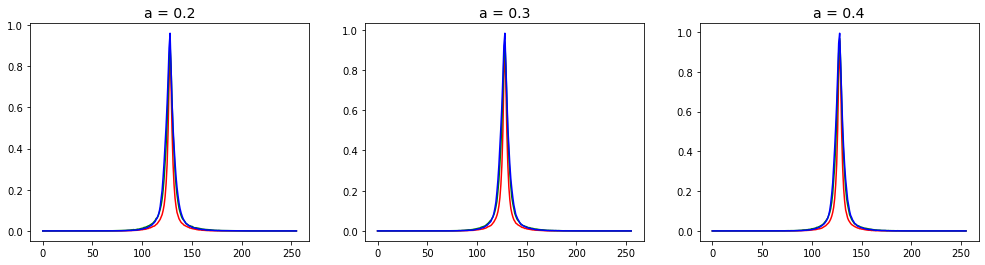

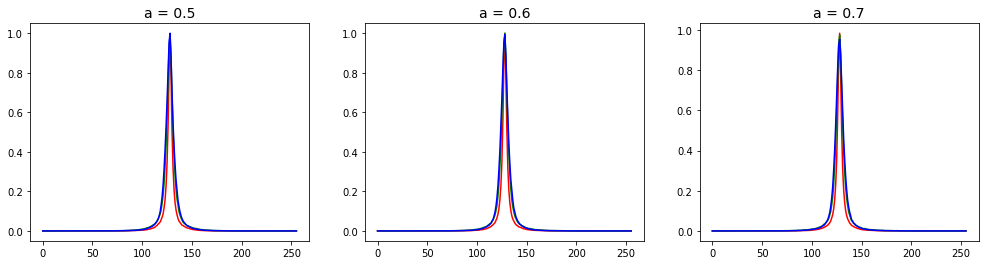

In [ ]:
# normalization and histogram plot (LENA)
Lena_R_histograms = Lena_R_histograms/np.max(Lena_R_histograms)
Lena_G_histograms = Lena_G_histograms/np.max(Lena_G_histograms)
Lena_B_histograms = Lena_B_histograms/np.max(Lena_B_histograms)
titles = ['a = '+str(round(i,1)) for i in a]

ax = np.zeros(len(a))
f, ax = plt.subplots(1, 3, figsize=(17, 4))
for i in range(3):
    ax[i].plot(Lena_R_histograms[i], color='r')
    ax[i].plot(Lena_G_histograms[i], color='g')
    ax[i].plot(Lena_B_histograms[i], color='b')
    ax[i].set_title(titles[i], fontsize=14)
    
f, ax = plt.subplots(1, 3, figsize=(17, 4))
for i in range(3):
    ax[i].plot(Lena_R_histograms[i+3], color='r')
    ax[i].plot(Lena_G_histograms[i+3], color='g')
    ax[i].plot(Lena_B_histograms[i+3], color='b')
    ax[i].set_title(titles[i+3], fontsize=14)

In [ ]:
Lena_ent_a_plots = []
for i in range(len(a)):
    ent = (entropies_R[i] + entropies_G[i] + entropies_B[i])/3
    Lena_ent_a_plots.append(ent)
    print('Εντροπία για την Lena για a = '+ str(round(a[i],1)) + ': '+ str(ent))

Εντροπία για την Lena για a = 0.2: 4.82101630491248
Εντροπία για την Lena για a = 0.3: 4.7426665276709
Εντροπία για την Lena για a = 0.4: 4.665844989465003
Εντροπία για την Lena για a = 0.5: 4.598933997397965
Εντροπία για την Lena για a = 0.6: 4.557702540845738
Εντροπία για την Lena για a = 0.7: 4.570758001260342


In [ ]:
# Camera
camera_histograms = []
entropies_camera = []
for i in range(len(a)):
    histograms, entropy = entropy_histograms(camera_LPT_a[i], a[i], depth=5)
    camera_histograms.append(histograms)
    entropies_camera.append(entropy)

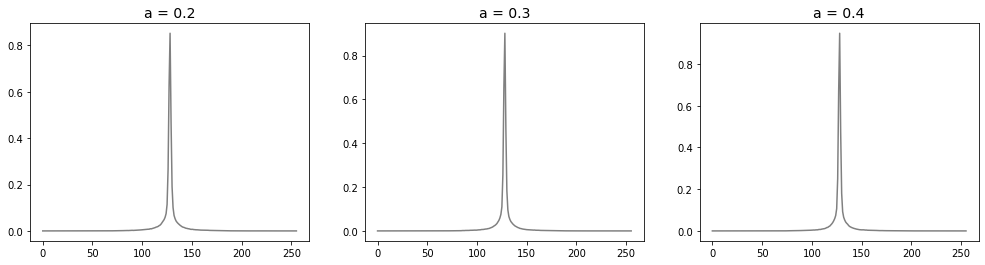

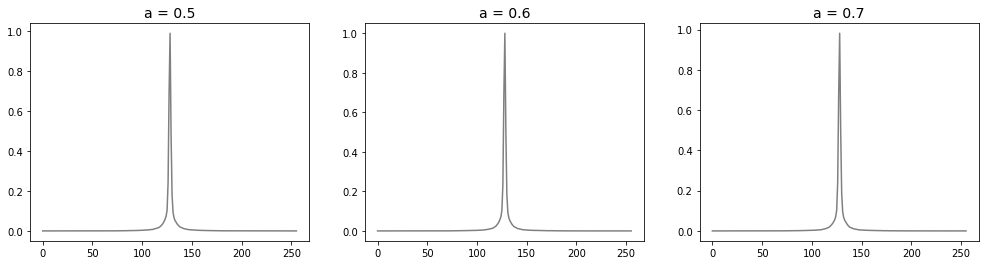

In [ ]:
# normalization and histogram plot (CAMERA)
camera_histograms = camera_histograms/np.max(camera_histograms)
titles = ['a = '+str(round(i,1)) for i in a]

ax = np.zeros(len(a))
f, ax = plt.subplots(1, 3, figsize=(17, 4))
for i in range(3):
    ax[i].plot(camera_histograms[i], color='gray')
    ax[i].set_title(titles[i], fontsize=14)
    
f, ax = plt.subplots(1, 3, figsize=(17, 4))
for i in range(3):
    ax[i].plot(camera_histograms[i+3], color='gray')
    ax[i].set_title(titles[i+3], fontsize=14)

In [ ]:
for i in range(len(a)):
    print('Εντροπία για την camera για a = '+ str(round(a[i],1)) + ': '+ str(entropies_camera[i]))

Εντροπία για την camera για a = 0.2: 4.314826663629778
Εντροπία για την camera για a = 0.3: 4.200184468333474
Εντροπία για την camera για a = 0.4: 4.089349408412672
Εντροπία για την camera για a = 0.5: 3.9939527671393797
Εντροπία για την camera για a = 0.6: 3.945277312814744
Εντροπία για την camera για a = 0.7: 3.9834546310372665


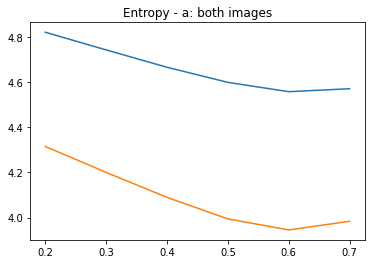

In [ ]:
plt.figure()
plt.plot(a, Lena_ent_a_plots)
plt.plot(a, entropies_camera)
_=plt.title("Entropy - a: both images")

Παρατηρούμε (και για τις δύο εικόνες) ότι όσο αυξάνουμε τις τιμές του 'a' μέχρι και το 0.6 η εντροπία μειώνεται, ενώ για 0.7 παρουσιάζει ξανά αύξηση. Η μείωση του 'a' οδηγεί σε πιο "κλειστά" ιστογράμματα, κάτι το οποίο παρατηρούμε από τις μέγιστες τιμές τους στις παραπάνω δοκιμές.

**Testing for different values of depth**

In [ ]:
# Lena Channel R
Lena_R_histograms = []
entropies_R = []
for i in range(len(depth)):
    histograms, entropy = entropy_histograms(Lena_R_depth[i], a=0.5, depth=depth[i])
    Lena_R_histograms.append(histograms)
    entropies_R.append(entropy)

In [ ]:
# Lena Channel G
Lena_G_histograms = []
entropies_G = []
for i in range(len(depth)):
    histograms, entropy = entropy_histograms(Lena_G_depth[i], a=0.5, depth=depth[i])
    Lena_G_histograms.append(histograms)
    entropies_G.append(entropy)

In [ ]:
# Lena Channel B
Lena_B_histograms = []
entropies_B = []
for i in range(len(depth)):
    histograms, entropy = entropy_histograms(Lena_B_depth[i], a=0.5, depth=depth[i])
    Lena_B_histograms.append(histograms)
    entropies_B.append(entropy)

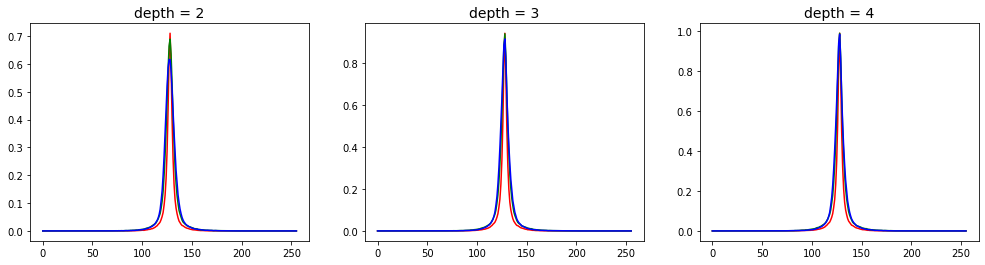

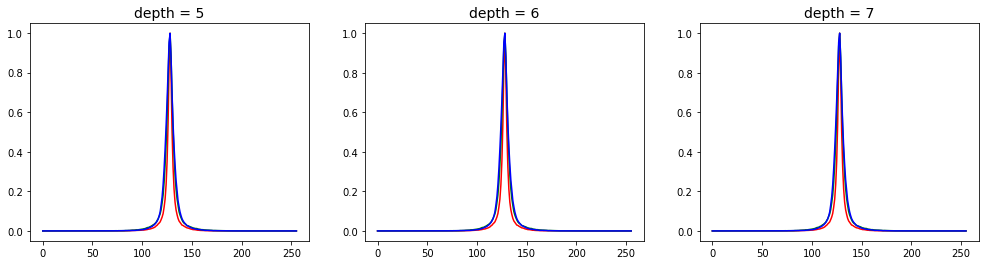

In [ ]:
# normalization and histogram plot (LENA)
Lena_R_histograms = Lena_R_histograms/np.max(Lena_R_histograms)
Lena_G_histograms = Lena_G_histograms/np.max(Lena_G_histograms)
Lena_B_histograms = Lena_B_histograms/np.max(Lena_B_histograms)
titles = ['depth = '+str(round(i,1)) for i in depth]

ax = np.zeros(len(depth))
f, ax = plt.subplots(1, 3, figsize=(17, 4))
for i in range(3):
    ax[i].plot(Lena_R_histograms[i], color='r')
    ax[i].plot(Lena_G_histograms[i], color='g')
    ax[i].plot(Lena_B_histograms[i], color='b')
    ax[i].set_title(titles[i], fontsize=14)
    
f, ax = plt.subplots(1, 3, figsize=(17, 4))
for i in range(3):
    ax[i].plot(Lena_R_histograms[i+3], color='r')
    ax[i].plot(Lena_G_histograms[i+3], color='g')
    ax[i].plot(Lena_B_histograms[i+3], color='b')
    ax[i].set_title(titles[i+3], fontsize=14)

In [ ]:
Lena_ent_depth_plots = []
for i in range(len(depth)):
    ent = (entropies_R[i] + entropies_G[i] + entropies_B[i])/3
    Lena_ent_depth_plots.append(ent)
    print('Εντροπία για την Lena για depth = '+ str(round(depth[i],1)) + ': '+ str(ent))

Εντροπία για την Lena για depth = 2: 4.579338288605046
Εντροπία για την Lena για depth = 3: 4.568323937782455
Εντροπία για την Lena για depth = 4: 4.5864244284627995
Εντροπία για την Lena για depth = 5: 4.598933997397965
Εντροπία για την Lena για depth = 6: 4.604181165926668
Εντροπία για την Lena για depth = 7: 4.605813308168785


In [ ]:
# Camera
camera_histograms = []
entropies_camera = []
for i in range(len(depth)):
    histograms, entropy = entropy_histograms(camera_LPT_depth[i], a=0.5, depth=depth[i])
    camera_histograms.append(histograms)
    entropies_camera.append(entropy)

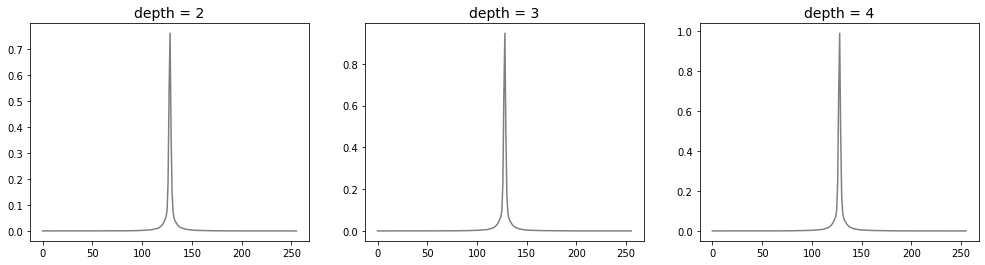

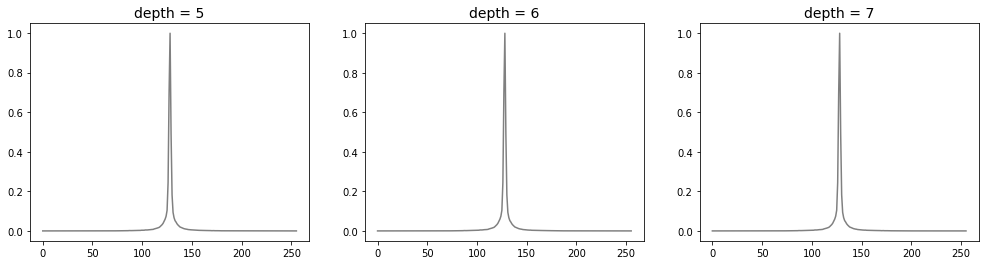

In [ ]:
# normalization and histogram plot (CAMERA)
camera_histograms = camera_histograms/np.max(camera_histograms)
titles = ['depth = '+str(round(i,1)) for i in depth]

ax = np.zeros(len(depth))
f, ax = plt.subplots(1, 3, figsize=(17, 4))
for i in range(3):
    ax[i].plot(camera_histograms[i], color='gray')
    ax[i].set_title(titles[i], fontsize=14)
    
f, ax = plt.subplots(1, 3, figsize=(17, 4))
for i in range(3):
    ax[i].plot(camera_histograms[i+3], color='gray')
    ax[i].set_title(titles[i+3], fontsize=14)

In [ ]:
for i in range(len(depth)):
    print('Εντροπία για την camera για depth = '+ str(round(depth[i],1)) + ': '+ str(entropies_camera[i]))

Εντροπία για την camera για depth = 2: 3.8818469958329516
Εντροπία για την camera για depth = 3: 3.955715682338795
Εντροπία για την camera για depth = 4: 3.9829255955214276
Εντροπία για την camera για depth = 5: 3.9939527671393797
Εντροπία για την camera για depth = 6: 3.998545085978385
Εντροπία για την camera για depth = 7: 4.000217293184207


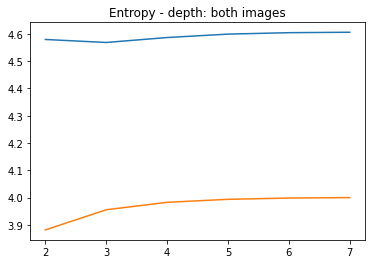

In [ ]:
plt.figure()
plt.plot(depth, Lena_ent_depth_plots)
plt.plot(depth, entropies_camera)
_=plt.title("Entropy - depth: both images")

Για σταθερό 'a' και αυξανόμενο depth η συμπεριφορά της εντροπίας είναι η αντίθετη από ότι για μεταβλητό 'a'. Όσο αυξάνουμε τα επίπεδα της Laplacian πυρμίδας η εντροπία αυξάνεται και εκείνη, ενώ τα αντίστοιχα ιστoγράμματα "ανοίγουν".

###### (ε) Finding optimal 'a' parameter

In [ ]:
def entropy_histogram (pyramid, a, depth):
    hist = cv2.calcHist([pyramid], [0], None, [256], [0, 256]) 
    entropy = st.entropy(hist, base=2)[0]
    return (hist, entropy)

In [ ]:
# Testing for Lena

def ent_var (level):
    all_entr = []
    all_var = []
    a = [0.2,0.3,0.4,0.5,0.6,0.7]
    
    print('--- Level {} ---'.format(level))
    for i in range(len(a)):
        
        print('For a = {}: '.format(round(a[i],1)))
        
        _, entropyR = entropy_histogram(Lena_R_a[i][level], a=a[i], depth=5)
        varianceR = np.var(Lena_R_a[i][level])
        
        _, entropyG = entropy_histogram(Lena_G_a[i][level], a=a[i], depth=5)
        varianceG = np.var(Lena_G_a[i][level])
        
        _, entropyB = entropy_histogram(Lena_B_a[i][level], a=a[i], depth=5)
        varianceB = np.var(Lena_B_a[i][level])
        
        total_entropy = (entropyR + entropyG + entropyB)/3
        total_variance = (varianceR + varianceG + varianceB)/3
        all_entr.append(total_entropy)
        all_var.append(total_variance)
        
        
        print('Channel R: entropy = {}, variance = {}'.format(entropyR, varianceR))
        print('Channel G: entropy = {}, variance = {}'.format(entropyG, varianceG))
        print('Channel B: entropy = {}, variance = {}'.format(entropyB, varianceB))
        print('Total entropy = {}\nTotal variance = {}'.format(total_entropy, total_variance))
        print()
    return all_entr,all_var 

In [ ]:
x0,v0 = ent_var(0)

--- Level 0 ---
For a = 0.2: 
Channel R: entropy = 4.549533843994141, variance = 59.131888756295666
Channel G: entropy = 4.997641563415527, variance = 106.70432259350491
Channel B: entropy = 4.9797186851501465, variance = 86.69457376211358
Total entropy = 4.842297871907552
Total variance = 84.17692837063805

For a = 0.3: 
Channel R: entropy = 4.452510356903076, variance = 50.91761030605994
Channel G: entropy = 4.904978275299072, variance = 92.32143947806617
Channel B: entropy = 4.907547473907471, variance = 77.22637540508003
Total entropy = 4.755011876424153
Total variance = 73.48847506306872

For a = 0.4: 
Channel R: entropy = 4.352553367614746, variance = 43.953075668774545
Channel G: entropy = 4.809041500091553, variance = 79.94689063435362
Channel B: entropy = 4.832800388336182, variance = 68.76588672793878
Total entropy = 4.664798100789388
Total variance = 64.22195101035565

For a = 0.5: 
Channel R: entropy = 4.259627819061279, variance = 38.69912736839615
Channel G: entropy = 4.7

In [ ]:
x1,v1 = ent_var(1)

--- Level 1 ---
For a = 0.2: 
Channel R: entropy = 4.467691421508789, variance = 66.206343755126
Channel G: entropy = 4.7726054191589355, variance = 90.97843579109758
Channel B: entropy = 4.281426429748535, variance = 43.750809874385595
Total entropy = 4.507241249084473
Total variance = 66.97852980686973

For a = 0.3: 
Channel R: entropy = 4.41498327255249, variance = 63.04786887392402
Channel G: entropy = 4.729495048522949, variance = 88.16575738415122
Channel B: entropy = 4.247186183929443, variance = 42.85238582990132
Total entropy = 4.463888168334961
Total variance = 64.68867069599219

For a = 0.4: 
Channel R: entropy = 4.38210391998291, variance = 61.2463366703596
Channel G: entropy = 4.700361251831055, variance = 87.68645408353768
Channel B: entropy = 4.239313125610352, variance = 43.43533180654049
Total entropy = 4.4405927658081055
Total variance = 64.12270752014592

For a = 0.5: 
Channel R: entropy = 4.370935440063477, variance = 61.79456466436386
Channel G: entropy = 4.7010431

In [ ]:
x2,v2 = ent_var(2)

--- Level 2 ---
For a = 0.2: 
Channel R: entropy = 5.02974271774292, variance = 105.69426223263144
Channel G: entropy = 5.3002543449401855, variance = 137.98729025945067
Channel B: entropy = 4.71760368347168, variance = 60.82850623130798
Total entropy = 5.015866915384929
Total variance = 101.5033529077967

For a = 0.3: 
Channel R: entropy = 4.9531121253967285, variance = 102.08546548709273
Channel G: entropy = 5.229048728942871, variance = 133.33835151419044
Channel B: entropy = 4.664133548736572, variance = 59.327582359313965
Total entropy = 4.948764801025391
Total variance = 98.25046645353238

For a = 0.4: 
Channel R: entropy = 4.8831329345703125, variance = 100.88123343884945
Channel G: entropy = 5.176887512207031, variance = 132.68711590394378
Channel B: entropy = 4.625570297241211, variance = 59.57903593406081
Total entropy = 4.895196914672852
Total variance = 97.71579509228468

For a = 0.5: 
Channel R: entropy = 4.845138072967529, variance = 104.97547040879726
Channel G: entropy 

In [ ]:
x3,v3 = ent_var(3)

--- Level 3 ---
For a = 0.2: 
Channel R: entropy = 5.558919429779053, variance = 159.77460950613022
Channel G: entropy = 5.7850141525268555, variance = 209.72242641448975
Channel B: entropy = 5.1317458152771, variance = 83.4133352637291
Total entropy = 5.491893132527669
Total variance = 150.97012372811636

For a = 0.3: 
Channel R: entropy = 5.487312316894531, variance = 154.86712211370468
Channel G: entropy = 5.743882656097412, variance = 205.21023219823837
Channel B: entropy = 5.0927815437316895, variance = 82.89170837402344
Total entropy = 5.441325505574544
Total variance = 147.6563542286555

For a = 0.4: 
Channel R: entropy = 5.433995246887207, variance = 154.7000539302826
Channel G: entropy = 5.704200267791748, variance = 207.19303220510483
Channel B: entropy = 5.087691307067871, variance = 85.739337682724
Total entropy = 5.408629099527995
Total variance = 149.21080793937048

For a = 0.5: 
Channel R: entropy = 5.397839069366455, variance = 163.7039551138878
Channel G: entropy = 5.7

In [ ]:
x4,v4 = ent_var(4)

--- Level 4 ---
For a = 0.2: 
Channel R: entropy = 6.80082368850708, variance = 1361.3036460876465
Channel G: entropy = 7.038227558135986, variance = 1426.626708984375
Channel B: entropy = 6.364043712615967, variance = 548.3200035095215
Total entropy = 6.734364827473958
Total variance = 1112.0834528605144

For a = 0.3: 
Channel R: entropy = 6.828926086425781, variance = 1444.7225179672241
Channel G: entropy = 7.106876850128174, variance = 1525.6860008239746
Channel B: entropy = 6.389359951019287, variance = 585.1079778671265
Total entropy = 6.775054295857747
Total variance = 1185.1721655527751

For a = 0.4: 
Channel R: entropy = 6.877875804901123, variance = 1544.544906616211
Channel G: entropy = 7.134550094604492, variance = 1645.7234563827515
Channel B: entropy = 6.430535793304443, variance = 631.222412109375
Total entropy = 6.814320882161458
Total variance = 1273.8302583694458

For a = 0.5: 
Channel R: entropy = 6.933187484741211, variance = 1671.6692724227905
Channel G: entropy = 7

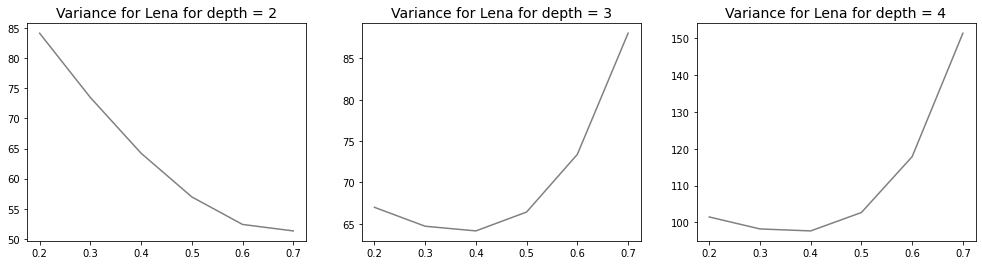

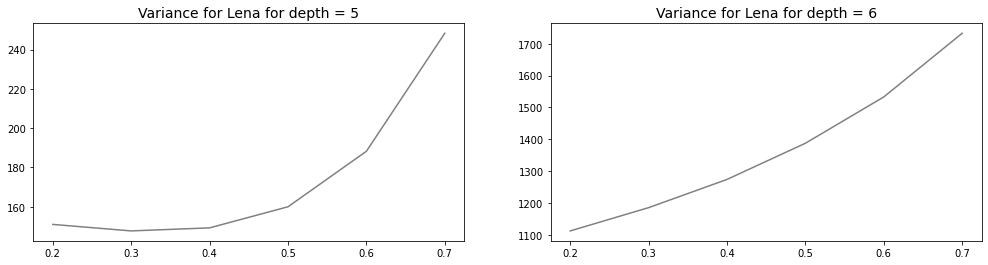

In [ ]:
# Ploting variance for each level
all_entr_lena = [v0,v1,v2,v3,v4]
ax = np.zeros(len(depth))
f, ax = plt.subplots(1, 3, figsize=(17, 4))
titles = ['Variance for Lena for depth = '+str(round(i,1)) for i in depth]
for i in range(3):
    ax[i].plot(a,all_entr_lena[i], color='gray')
    ax[i].set_title(titles[i], fontsize=14)
    
f, ax = plt.subplots(1, 2, figsize=(17, 4))
for i in range(2):
    ax[i].plot(a,all_entr_lena[i+3], color='gray')
    ax[i].set_title(titles[i+3], fontsize=14)   
    

Ενώ το επιθμητό αποτέλεσμα (όπως είδαμε και στο προηγούμενο ερώτημα με την ελαχιστοποίηση της εντροπίας) είναι το 'a' = 0.6, παρατηρώντας τα αποτελέσματα για κάθε επίπεδο κάθε πυραμίδας δεν καταλήγουμε στο ίδιο συμπέρασμα. Οι τιμές της εντροπίας και της διακύμανσης δεν ελαχιστοποιούνται στο 'a' = 0.6. Αυτό μπορεί να δικαιολογηθεί καθώς η συμπεριφορά σε κάθε επίπεδο αυτών των ποσοτήτων μπορεί να είναι αρκετά διαφορετική, από το αποτέλεσμα για όλη την Λαπλασιανή πυραμίδα. Επομένως για να έχουμε μία καλύτερη εικόνα θα υπολογίσουμε τους μέσους όρους της εντροπίας σε κάθε επίπεδο, ώστε να δούμε τα αποτελέσματα συνολικά για όλη την πυραμίδα (και μεταβλητό 'a'). Επισημαίνεται ότι όσον αφορά την διακύμανση παρατηρούμε ότι στα μεσαία επίπεδα παρουσιάζει ελάχιστο στο 0.4. Αυτό είναι πιθανό να οφείλεται σε σφάλματα από τον υπολογισμό της στα επιμέρους επίπεδα, και όχι συνολικά.

In [ ]:
# Results for the Laplacian pyramid for Lena
entr = []

for i in range(len(a)):
    entropy = (x0[i] + x1[i] + x2[i] + x3[i] +x4[i])/6
    entr.append(entropy)
    print('For a =' ,round(a[i],1),'entropy = ',entropy)

For a = 0.2 entropy =  4.43194399939643
For a = 0.3 entropy =  4.397340774536132
For a = 0.4 entropy =  4.3705896271599665
For a = 0.5 entropy =  4.3606713612874355
For a = 0.6 entropy =  4.3800961176554365
For a = 0.7 entropy =  4.46852281358507


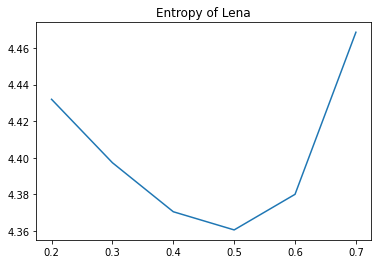

In [ ]:
plt.figure()
plt.plot(a,entr)
_ = plt.title('Entropy of Lena')

Παρατηρούμε ότι η ελεχιστοποίηση της εντροπίας είναι κοντά στο 'a' = 0.5. Αυτό πιθανώς οφείλεται σε σφάλματα από τους επιμέρους υπολογισμούς και τον μέσο όρο, καθώς η διαδικασία υπολογισμού της εντροπίας για όλη την πυραμίδα παρουσιάστηκε με περισσότερη ακρίβεια στο προηγούμενο ερώτημα. Παρ'όλα αυτά το αποτέλεσμα δεν απέχει πολύ από το επιθυμητό, καθώς βλέπουμε ότι και στο 'a' = 0.6  η εντροπία έχει μικρή τιμή σε σχέση με τα υπόλοιπα 'a'.

In [ ]:
# Testing for camera
def ent_var_camera (level):
    a = [0.2,0.3,0.4,0.5,0.6,0.7]
    entropy = []
    var = []
    print('--- Level {} ---'.format(level))
    for i in range(len(a)):
        
        print('For a = {}: '.format(round(a[i],1)))
        
        _, entropyC = entropy_histogram(camera_LPT_a[i][level], a=a[i], depth=5)
        varianceC = np.var(camera_LPT_a[i][level])
        entropy.append(entropyC)
        var.append(varianceC)
        print('Camera: entropy = {}, variance = {}'.format(entropyC, varianceC))
        print()
    return entropy,var

In [ ]:
en0,vc0 = ent_var_camera(0)

--- Level 0 ---
For a = 0.2: 
Camera: entropy = 4.281501770019531, variance = 96.77334065170726

For a = 0.3: 
Camera: entropy = 4.143211364746094, variance = 80.21181488124421

For a = 0.4: 
Camera: entropy = 4.00554895401001, variance = 66.80453288316494

For a = 0.5: 
Camera: entropy = 3.8818471431732178, variance = 57.08173751452705

For a = 0.6: 
Camera: entropy = 3.7935781478881836, variance = 51.61894939880585

For a = 0.7: 
Camera: entropy = 3.7818894386291504, variance = 51.02431152429199



In [ ]:
en1,vc1 = ent_var_camera(1)

--- Level 1 ---
For a = 0.2: 
Camera: entropy = 4.315592288970947, variance = 112.57308082934469

For a = 0.3: 
Camera: entropy = 4.274700164794922, variance = 109.14415783784352

For a = 0.4: 
Camera: entropy = 4.241631507873535, variance = 107.70829271897674

For a = 0.5: 
Camera: entropy = 4.227192401885986, variance = 110.00577071961015

For a = 0.6: 
Camera: entropy = 4.280720233917236, variance = 118.6922040246427

For a = 0.7: 
Camera: entropy = 4.418220520019531, variance = 137.89529618248343



In [ ]:
en2,vc2 = ent_var_camera(2)

--- Level 2 ---
For a = 0.2: 
Camera: entropy = 4.488831996917725, variance = 132.67111986503005

For a = 0.3: 
Camera: entropy = 4.468209266662598, variance = 131.7426293939352

For a = 0.4: 
Camera: entropy = 4.466889381408691, variance = 135.89385604858398

For a = 0.5: 
Camera: entropy = 4.471513271331787, variance = 149.24633334577084

For a = 0.6: 
Camera: entropy = 4.562246799468994, variance = 179.05726620182395

For a = 0.7: 
Camera: entropy = 4.8043389320373535, variance = 236.19251495227218



In [ ]:
en3,vc3 = ent_var_camera(3)

--- Level 3 ---
For a = 0.2: 
Camera: entropy = 4.935290336608887, variance = 170.05950331687927

For a = 0.3: 
Camera: entropy = 4.877305030822754, variance = 170.67063903808594

For a = 0.4: 
Camera: entropy = 4.832664489746094, variance = 177.96808528900146

For a = 0.5: 
Camera: entropy = 4.785062313079834, variance = 198.85346502065659

For a = 0.6: 
Camera: entropy = 4.803908348083496, variance = 245.01548767089844

For a = 0.7: 
Camera: entropy = 5.055398941040039, variance = 334.6831395626068



In [ ]:
en4,vc4 = ent_var_camera(4)

--- Level 4 ---
For a = 0.2: 
Camera: entropy = 6.951045989990234, variance = 2608.2785787582397

For a = 0.3: 
Camera: entropy = 6.913185119628906, variance = 2683.7953147888184

For a = 0.4: 
Camera: entropy = 6.894820213317871, variance = 2775.0773458480835

For a = 0.5: 
Camera: entropy = 6.876802444458008, variance = 2892.0007314682007

For a = 0.6: 
Camera: entropy = 6.884949684143066, variance = 3049.8676147460938

For a = 0.7: 
Camera: entropy = 7.006593704223633, variance = 3256.089644432068



Όπως και προηγουμένως, η εντροπία και η διακύμανση δεν έχουν την αναμενόμενη συμπεριφορά. Θα υπολογίσουμε την εντροπία για όλη την Laplacian πυραμίδα, παίρνωντας τον μέσο όρο από τα παραπάνω αποτελέσματα και την διακύμανση για κάθε επίπεδο.

In [ ]:
# Results for the Laplacian pyramid for Camera
entr = []
for i in range(len(a)):
    entropy = (en0[i] + en1[i] + en2[i] + en3[i] +en4[i])/6
    entr.append(entropy)
    print('For a =' ,round(a[i],1),'entropy = ',entropy)

For a = 0.2 entropy =  4.1620438893636065
For a = 0.3 entropy =  4.112768491109212
For a = 0.4 entropy =  4.07359250386556
For a = 0.5 entropy =  4.040403048197429
For a = 0.6 entropy =  4.054233551025391
For a = 0.7 entropy =  4.177740097045898


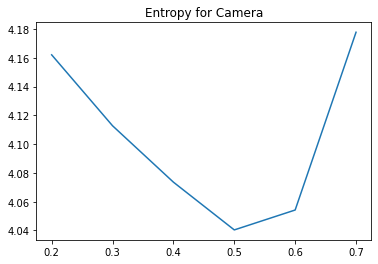

In [ ]:
plt.plot(a,entr)
_ = plt.title('Entropy for Camera')

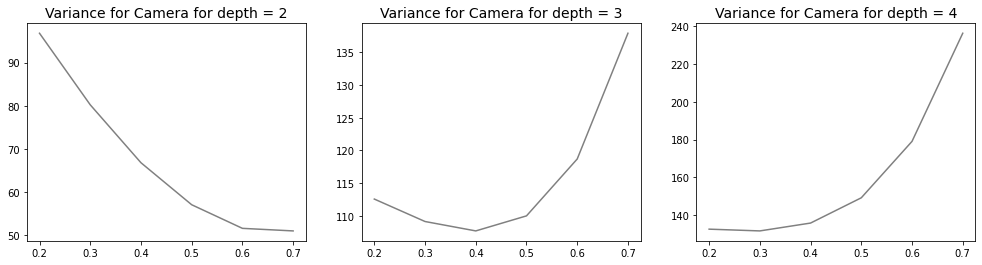

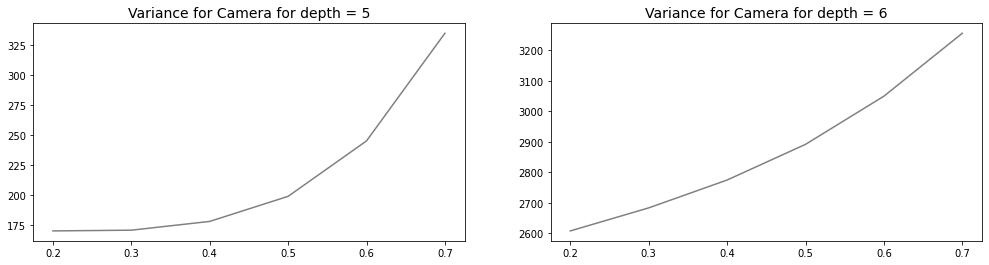

In [ ]:
# Ploting variance for each level
all_entr_camera = [vc0,vc1,vc2,vc3,vc4]
ax = np.zeros(len(depth))
f, ax = plt.subplots(1, 3, figsize=(17, 4))
titles = ['Variance for Camera for depth = '+str(round(i,1)) for i in depth]
for i in range(3):
    ax[i].plot(a,all_entr_camera[i], color='gray')
    ax[i].set_title(titles[i], fontsize=14)
    
f, ax = plt.subplots(1, 2, figsize=(17, 4))
for i in range(2):
    ax[i].plot(a,all_entr_camera[i+3], color='gray')
    ax[i].set_title(titles[i+3], fontsize=14)   
    

Τα συμπεράσματα είναι τα ίδια με αυτά της εικόνας Lena.

###### (στ) Quantizing for optimal 'a' parameter

In [ ]:
def quantize_lena(bins):
    quant_R = []
    quant_G = []
    quant_B = []
    for i in range(len(bins)):
        r = L_Quantization(Lena_R_a[4][i],bins[i])
        g = L_Quantization(Lena_G_a[4][i],bins[i])
        b = L_Quantization(Lena_B_a[4][i],bins[i])
        quant_R.append(r)
        quant_G.append(g)
        quant_B.append(b)
        
    Dec_R = L_Pyramid_Decode(quant_R,0.6)
    Dec_G = L_Pyramid_Decode(quant_G,0.6)
    Dec_B = L_Pyramid_Decode(quant_B,0.6)
    Decoded_Lena = cv2.merge((Dec_R,Dec_G,Dec_B))
    return (quant_R,quant_G,quant_B,Decoded_Lena)

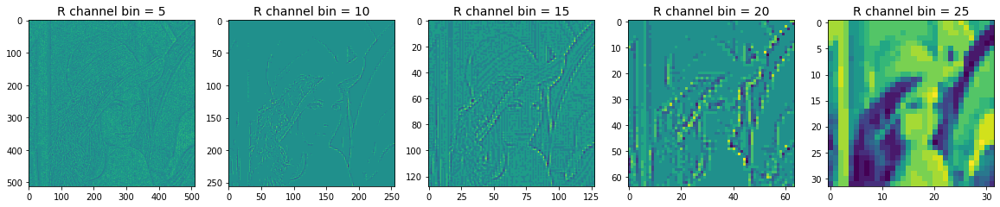

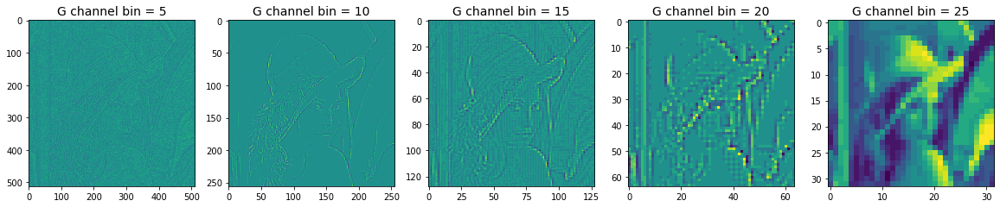

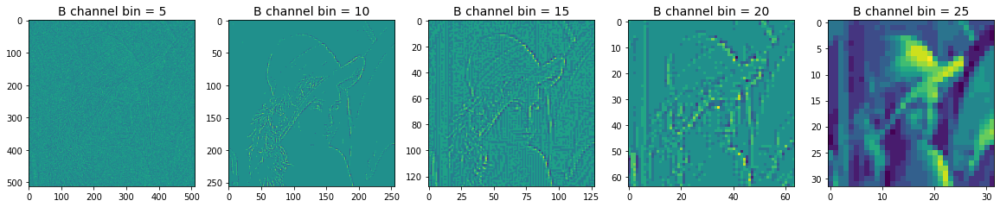

In [ ]:
# Quantization of Lena for initial bins = 5
bins = [5, 10, 15, 20, 25]
quant_R,quant_G,quant_B,Decoded_Lena1 = quantize_lena(bins)
titles = ['R channel bin = '+str(round(i,1)) for i in bins]
printMultiple(quant_R,titles,'R') 
titles = ['G channel bin = '+str(round(i,1)) for i in bins]
printMultiple(quant_G,titles,'G')
titles = ['B channel bin = '+str(round(i,1)) for i in bins]
printMultiple(quant_B,titles,'G')

Total entropy 1.9549348361028158
(512, 512, 3)


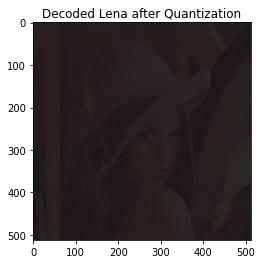

In [ ]:
#Entropy 
histr,entropyr = entropy_histograms (quant_R, 0.6, 5)
histg,entropyg = entropy_histograms (quant_G, 0.6, 5)
histg,entropyb = entropy_histograms (quant_B, 0.6, 5)
print('Total entropy',(entropyr+entropyg+entropyb)/3)
# Reconstruction of Lena
plt.imshow(Decoded_Lena1)
print(Decoded_Lena1.shape)
_ = plt.title('Decoded Lena after Quantization')

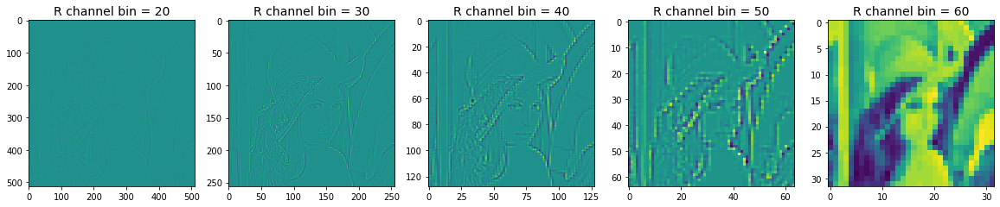

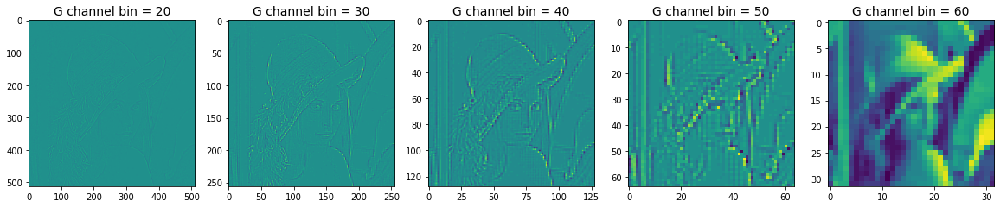

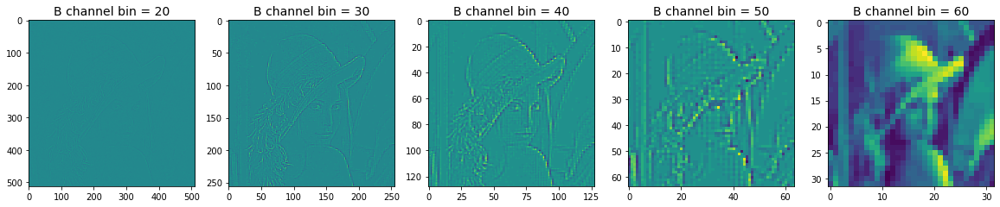

In [ ]:
# Quantization of Lena for initial bins = 20
bins = [20,30,40,50,60]
quant_R,quant_G,quant_B,Decoded_Lena2 = quantize_lena(bins)
titles = ['R channel bin = '+str(round(i,1)) for i in bins]
printMultiple(quant_R,titles,'R') 
titles = ['G channel bin = '+str(round(i,1)) for i in bins]
printMultiple(quant_G,titles,'G')
titles = ['B channel bin = '+str(round(i,1)) for i in bins]
printMultiple(quant_B,titles,'G')

Total entropy 2.142484436375915


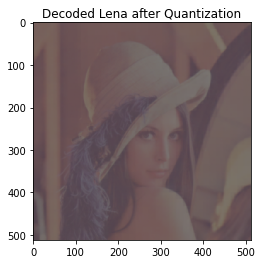

In [ ]:
# Reconstruction of Lena
histr,entropyr = entropy_histograms (quant_R, 0.6, 5)
histg,entropyg = entropy_histograms (quant_G, 0.6, 5)
histg,entropyb = entropy_histograms (quant_B, 0.6, 5)
print('Total entropy',(entropyr+entropyg+entropyb)/3)
plt.imshow(Decoded_Lena2)
_ = plt.title('Decoded Lena after Quantization')

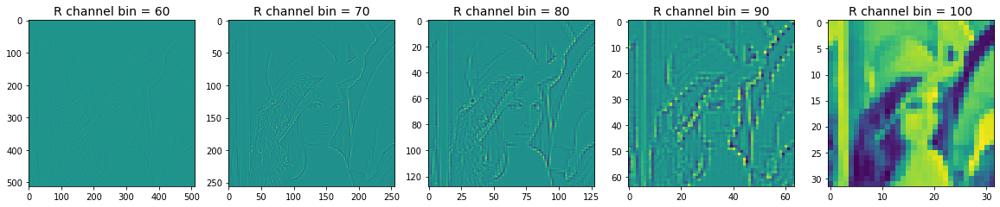

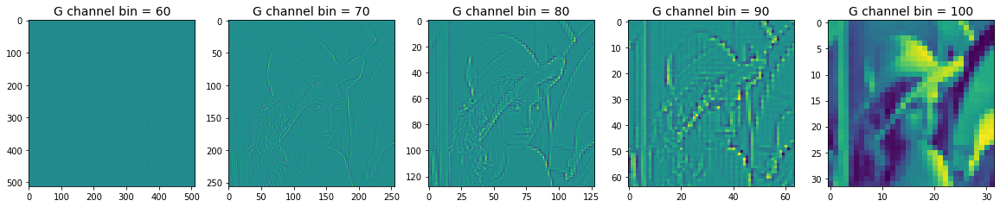

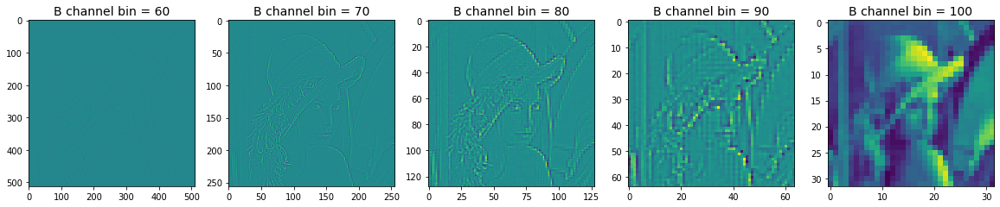

In [ ]:
# Quantization of Lena for initial bins = 60
bins = [60,70,80,90,100]
quant_R,quant_G,quant_B,Decoded_Lena3 = quantize_lena(bins)
titles = ['R channel bin = '+str(round(i,1)) for i in bins]
printMultiple(quant_R,titles,'R') 
titles = ['G channel bin = '+str(round(i,1)) for i in bins]
printMultiple(quant_G,titles,'G')
titles = ['B channel bin = '+str(round(i,1)) for i in bins]
printMultiple(quant_B,titles,'G')

Total entropy 3.3311587546247536


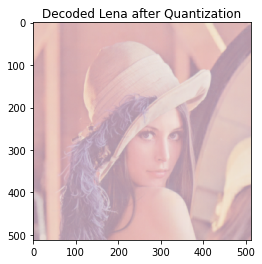

In [ ]:
# Reconstruction of Lena
histr,entropyr = entropy_histograms (quant_R, 0.6, 5)
histg,entropyg = entropy_histograms (quant_G, 0.6, 5)
histg,entropyb = entropy_histograms (quant_B, 0.6, 5)
print('Total entropy',(entropyr+entropyg+entropyb)/3)
plt.imshow(Decoded_Lena3)
_ = plt.title('Decoded Lena after Quantization')

In [ ]:
def quantize_camera(bins):
    quant_camera = []
    for i in range(len(bins)):
        c = L_Quantization(camera_LPT_a[4][i],bins[i])
        quant_camera.append(c) 
    Decoded_Camera = L_Pyramid_Decode(quant_camera,0.6)
    return(quant_camera,Decoded_Camera)
    

Entropy of camera 1.9375956373591647


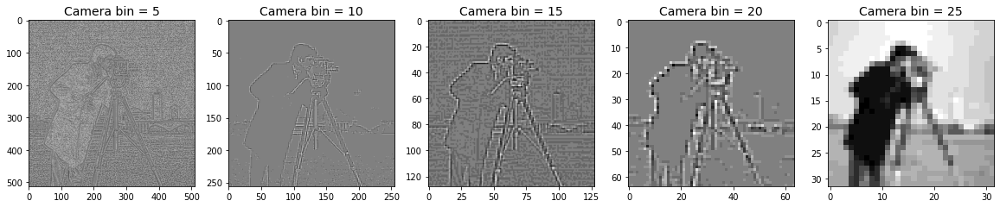

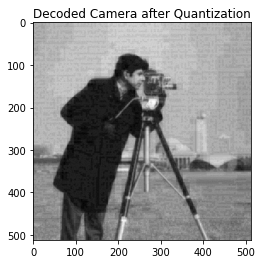

In [ ]:
# Quantization of Camera for initial bins = 5
bins = [5,10,15,20,25]
quant_camera,Decoded_Camera1 = quantize_camera(bins)
titles = ['Camera bin = '+str(round(i,1)) for i in bins]
printMultiple(quant_camera,titles,'gray') 
histg,entropyb = entropy_histograms (quant_camera, 0.6, 5)
print('Entropy of camera',entropyb)
plt.figure()
plt.imshow(Decoded_Camera1,cmap = 'gray')
_ = plt.title('Decoded Camera after Quantization')

Entropy of camera 1.9878964055684383


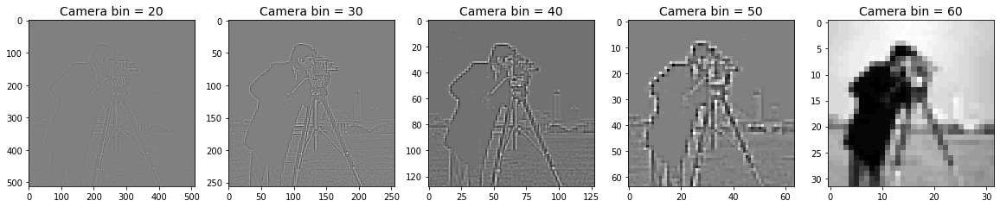

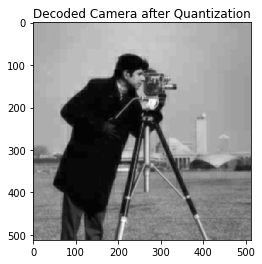

In [ ]:
# Quantization of Camera for initial bins = 20
bins = [20,30,40,50,60]
quant_camera,Decoded_Camera2 = quantize_camera(bins)
titles = ['Camera bin = '+str(round(i,1)) for i in bins]
printMultiple(quant_camera,titles,'gray')
histg,entropyb = entropy_histograms (quant_camera, 0.6, 5)
print('Entropy of camera',entropyb)
plt.figure()
plt.imshow(Decoded_Camera2,cmap = 'gray')
_ = plt.title('Decoded Camera after Quantization')

Entropy of camera 2.8450392943304768


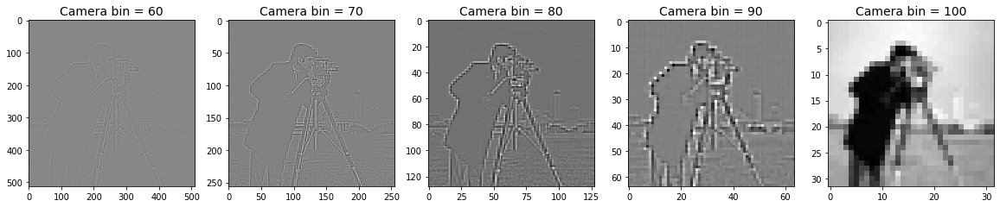

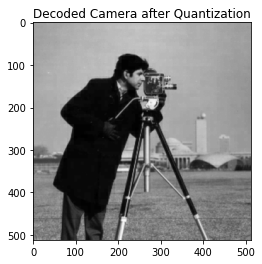

In [ ]:
# Quantization of Camera for initial bins = 60
bins = [60,70,80,90,100]
quant_camera,Decoded_Camera3 = quantize_camera(bins)
titles = ['Camera bin = '+str(round(i,1)) for i in bins]
printMultiple(quant_camera,titles,'gray') 
histg,entropyb = entropy_histograms (quant_camera, 0.6, 5)
print('Entropy of camera',entropyb)
plt.figure()
plt.imshow(Decoded_Camera3,cmap = 'gray')
_ = plt.title('Decoded Camera after Quantization')

Από το paper γνωρίζουμε ότι το binsize σε μία Laplacian πυραμίδα εντιπροσωπεύει την ευαισθησία ενός παρατηρητή σε σφάλματα σε ζώνες χωρικής συχνότητας. Οι άνθρωποι είναι ευαίσθητοι σε μεταβολές χαμηλής και μεσαίας χωρικής συχνότητας και γι'αυτό αυξάνουμε το binsize στην κβάντιση όσο αναεβαίνουμε επίπεδα στην Laplacian πυραμίδα. Ώστόσο, σε καμία δοκιμή δεν υπάρχει πλήρης ανακατασκευή της εικόνας. Βέβαια όσο αυξάνουμε το binsize παρατηρούμε ότι η εντροπία και των δύο εικόνων αυξάνεται. Συμπαιρένουμε λοιπόν ότι είναι εφικτό να χρησιμοποιήσουμε λίγα bits κωδικοποίησης (μικρό binsize) και να πετύχουμε ικανοποιητικά εποτελέσματα.

###### (ζ) Finding SNR  for initial and reconstracted images after quantization

In [ ]:
# Fuction to compute SNR
from math import log10, sqrt
def PSNR(original, compressed):
    mse = np.mean((original - compressed) ** 2)
    if(mse == 0):  # MSE is zero means no noise is present in the signal .
                  # Therefore PSNR have no importance.
        return 100
    max_pixel = 255.0
    psnr = 20 * log10(max_pixel / sqrt(mse))
    return psnr

In [ ]:
# Save all decoded images
All_decoded_lena = [Decoded_Lena1,Decoded_Lena2,Decoded_Lena3]
All_decoded_camera = [Decoded_Camera1,Decoded_Camera2,Decoded_Camera3]
bin = [5,20,60]
for i in range(3):
    print('SNR of Lena for initial',bin[i],'bins is', PSNR(RGB_Lena,All_decoded_lena[i]))
print()
for i in range(3):
    print('SNR of Camera for initial',bin[i],'bins is', PSNR(camera,All_decoded_camera[i]))

SNR of Lena for initial 5 bins is 27.82015758557482
SNR of Lena for initial 20 bins is 28.010666808141576
SNR of Lena for initial 60 bins is 27.823651308245545

SNR of Camera for initial 5 bins is 28.598406687471897
SNR of Camera for initial 20 bins is 27.699181475729517
SNR of Camera for initial 60 bins is 27.515407957341516


Η αύξηση του binsize που έχει εφαρμοστεί στο προηγούμενο ερώτημα δεν επηρεάζει το bit rate των εικόνων, καθώς έχει μικρή πυκνότητα σε δείγματα. Η λανθασμέμη ανακατασκευή, την οποία το ανθρώπινο μάτι αντιλαμβάνεται μετά τον κβαντισμό φαίνεται και από το SNR που προκύπτει, το οποίο είναι για όλες τις δοκιμές κοντά στα 30dB. Η έγχρωμη εικόνα επηρεάζεται περισσότερο και αυτό το παρατηρούμε από τις ελαφρώς αυξημένες σε σχέση με της grayscale εικόνας τιμές του SNR.